## ROI Correlation analysis with All 160 ABCD ASD Samples.
##

In [1]:
import os, sys
import cupy as cp

import re
import json
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import math
from matplotlib.colors import LogNorm

import concurrent.futures

from functools import partial
from tqdm import tqdm
from scipy.stats import spearmanr, permutation_test, mannwhitneyu, PermutationMethod, false_discovery_control, rankdata
ATLAS = "AAL+CSF"
workdir = "../braintypicality/workdir/cuda_opt/learnable"

TEN_PERCENT = 0.1
FIVE_PERCENT = 0.05
ONE_PERCENT = 0.01

In [2]:
""" The AAL (Automated Anatomical Labeling) atlas is a commonly used brain atlas in MRI studies, 
dividing the brain into standardized anatomical regions, which helps with consistent mapping and analysis. 
CSF (Cerebrospinal Fluid) represents the fluid surrounding the brain, often included in analyses to separate neural signals 
from fluid signals. Together, “AAL+CSF” indicates that both brain regions and CSF areas are included """

' The AAL (Automated Anatomical Labeling) atlas is a commonly used brain atlas in MRI studies, \ndividing the brain into standardized anatomical regions, which helps with consistent mapping and analysis. \nCSF (Cerebrospinal Fluid) represents the fluid surrounding the brain, often included in analyses to separate neural signals \nfrom fluid signals. Together, “AAL+CSF” indicates that both brain regions and CSF areas are included '

## Loading Voxel-wise Scores

In [3]:
PATH_atlas_mapping = 'roi_behavior_correlations/'
with open(f'{PATH_atlas_mapping}aal-atlas-name-mapping.json', 'r') as file:
    short_to_desc = json.load(file)
short_to_desc['background'] = "Background"
short_to_desc['Frontal_Sup_Orb_L'] = 'Left Superior frontal gyrus, orbital part'
short_to_desc['Frontal_Sup_Orb_R'] = 'Right Superior frontal gyrus, orbital part'
short_to_desc['Parietal_Inf_L']    = 'Left Inferior parietal'
short_to_desc['Parietal_Inf_R']    = 'Right Inferior parietal'

In [4]:
roi_score_likelihoods = pd.read_csv(f"{workdir}/eval/heatmaps_v2/roi/{ATLAS}_roi_harmonized_likelihoods_abcd_ibis_conte.csv").rename(columns=short_to_desc)
roi_columns = roi_score_likelihoods.columns.difference(['Cohort', "ID"])

In [5]:
reference_likelihoods = pd.read_csv(f"{workdir}/eval/heatmaps_v2/roi/training-{ATLAS}_roi_likelihoods.csv").rename(columns=short_to_desc)

In [6]:
reference_likelihoods.shape

(330, 118)

### Full names are adopted from various sources:

#### CBCL
- https://www.parinc.com/docs/default-source/product-resources/sample_c15.pdf
- http://crisisresponse.promoteprevent.org/webfm_send/2475

#### DAS
- https://www.myschoolpsychology.com/wp-content/uploads/2014/02/Differential-Ability-Scales.pdf

#### Vineland-II
- https://www.ualberta.ca/en/community-university-partnership/media-library/community-university-partnership/resources/tools---assessment/vinelandjune-2012.pdf

In [7]:
behavior_column_map = {
    
  "CBCL-aggr_behav_score": "CBCL-Aggressive Behavior",
  "CBCL-anx_prob_score": "CBCL-Anxiety Problems",
  "CBCL-anxious_score": "CBCL-Anxious/Depressed",
  "CBCL-attention_hyper_prob_score": "CBCL-Attention Deficit/Hyperactivity Problems",
  "CBCL-attention_prob_score": "CBCL-Attention Problems",
  "CBCL-conduct_prob_score": "CBCL-Conduct Problems",
  "CBCL-depressed_score": "CBCL-Withdrawn/Depressed",
  "CBCL-depressive_prob_score": "CBCL-Depressive Problems",
  "CBCL-externalizing_score": "CBCL-Externalizing Problems",
  "CBCL-internalizing_score": "CBCL-Internalizing Problems",
  "CBCL-obsessive_comp_prob_score": "CBCL-Obsessive-Compulsive Problems",
  "CBCL-oppo_def_prob_score": "CBCL-Oppositional Defiant Problems",
  "CBCL-rule_break_behav_score": "CBCL-Rule-Breaking Behavior",
  "CBCL-sluggish_cogn_tempo_score": "CBCL-Sluggish Cognitive Tempo",
  "CBCL-social_prob_score": "CBCL-Social Problems",
  "CBCL-som_comp_score": "CBCL-Somatic Complaints",
  "CBCL-som_prob_score": "CBCL-Somatic Problems",
  "CBCL-stress_prob_score": "CBCL-Stress Problems",
  "CBCL-thought_prob_score": "CBCL-Thought Problems",
  "CBCL-total_problems_score": "CBCL-Total Problems",
  
  "VSA DAS_SA,PC_ABILITY_SCORE": "DAS-Pattern Construction",
  "VSA DAS_SA,matrices_ABILITY_SCORE": "DAS-Matrices",
  "VSA DAS_SA,rd_ABILITY_SCORE": "DAS-Recall of Designs",
  "VSA DAS_SA,seq_qr_ABILITY_SCORE": "DAS-Sequential and Quantitative Reasoning",
  "VSA DAS_SA,verbal_similarities_ABILITY_SCORE": "DAS-Verbal Similarities",
  "VSA DAS_SA,word_defn_ABILITY_SCORE": "DAS-Word Definitions",
    
  "Vineland-community_RAW_SCORE": "Vineland-II-Community Living Skills",
  "Vineland-copy_skills_RAW_SCORE": "Vineland-II-Coping Skills",
  "Vineland-domestic_RAW_SCORE": "Vineland-II-Domestic Skills",
  "Vineland-expressive_RAW_SCORE": "Vineland-II-Expressive Communication",
  "Vineland-fine_motor_RAW_SCORE": "Vineland-II-Fine Motor Skills",
  "Vineland-gross_motor_RAW_SCORE": "Vineland-II-Gross Motor Skills",
  "Vineland-inter_pers_rel_RAW_SCORE": "Vineland-II-Interpersonal Relationships",
  "Vineland-personal_RAW_SCORE": "Vineland-II-Personal Living Skills",
  "Vineland-play_leisure_RAW_SCORE": "Vineland-II-Play and Leisure Skills",
  "Vineland-receptive_RAW_SCORE": "Vineland-II-Receptive Communication",
  "Vineland-written_RAW_SCORE": "Vineland-II-Written Communication",


  'V24 ADOS_Derived,restricted_repetitive_behavior_total': 'ADOS Restricted and Repetitive Behavior Total (24 M)',
  'V36 ADOS_Derived,restricted_repetitive_behavior_total': 'ADOS Restricted and Repetitive Behavior Total (36 M)',
  'V37Plus ADOS_Derived,restricted_repetitive_behavior_total': 'ADOS Restricted and Repetitive Behavior Total (37+ M)',
  
  'V24 ADOS_Derived,severity_score_lookup': 'ADOS Overall Severity (24 M)',
  'V36 ADOS_Derived,severity_score_lookup': 'ADOS Overall Severity (36 M)',
  'V37Plus ADOS_Derived,severity_score_lookup': 'ADOS Overall Severity (37+ M)',
  
  'V24 ADOS_Derived,social_affect_restricted_repetitive_behavior_total': 'ADOS Social Affect and Restricted and Repetitive Behavior Total (24 M)',
  'V36 ADOS_Derived,social_affect_restricted_repetitive_behavior_total': 'ADOS Social Affect and Restricted and Repetitive Behavior Total (36 M)',
  'V37Plus ADOS_Derived,social_affect_restricted_repetitive_behavior_total': 'ADOS Social Affect and Restricted and Repetitive Behavior Total (37+ M)',
  
  'V24 ADOS_Derived,social_affect_total': 'ADOS Social Affect Total (24 M)',
  'V36 ADOS_Derived,social_affect_total': 'ADOS Social Affect Total (36 M)',
  'V37Plus ADOS_Derived,social_affect_total': 'ADOS Social Affect Total (37+ M)'
}



In [8]:
# Switching keys and values
behavior_column_map_inv = {value: key for key, value in behavior_column_map.items()}

In [9]:
abcd_asd_metadata = pd.read_csv("abcd_metadata/abcd_asd_cbcl_raw_scores_baseline.csv")

cbcl_cols = list(
    filter(
        lambda c: re.match(".*CBCL.*(?<!T)_score", c),
        abcd_asd_metadata.columns,
    )
)

behavior_cols = cbcl_cols

# abcd_asd_metadata[behavior_cols].info()

In [10]:
# abcd_asd_metadata

In [11]:
roi_score_likelihoods.Cohort.value_counts()

Cohort
ABCD-Val-Test      328
ABCD-ASD           163
IBIS-LR-Typical     82
IBIS-ASD            61
IBIS-DS              4
Name: count, dtype: int64

In [12]:
datadf_all_columns = pd.merge(roi_score_likelihoods, abcd_asd_metadata, on="ID").drop_duplicates(subset='ID')
datadf_all_columns.info()

<class 'pandas.core.frame.DataFrame'>
Index: 160 entries, 0 to 161
Columns: 140 entries, ID to CBCL-total_problems_score
dtypes: float64(138), object(2)
memory usage: 176.2+ KB


## Manually select regions and behaviors. (related to ASD)

In [13]:
# Relevant columns to keep
columns_to_keep = [
    'ID',
    #"Cohort",
    #'Sex',

    # Brain regions related to ASD
    "Left Precentral gyrus", "Right Precentral gyrus",
    "Left Superior frontal gyrus, dorsolateral", "Right Superior frontal gyrus, dorsolateral",
    "Left Middle frontal gyrus", "Right Middle frontal gyrus",
    "Left Inferior frontal gyrus, triangular part", "Right Inferior frontal gyrus, triangular part",
    "Left Insula", "Right Insula",
    "Left Anterior cingulate and paracingulate gyri", "Right Anterior cingulate and paracingulate gyri",
    "Left Posterior cingulate gyrus", "Right Posterior cingulate gyrus",
    "Left Fusiform gyrus", "Right Fusiform gyrus",
    "Left Superior temporal gyrus", "Right Superior temporal gyrus",
    "Left Superior parietal gyrus", "Right Superior parietal gyrus",
    "Left Precuneus", "Right Precuneus",
    "Left Cuneus", "Right Cuneus",
    "Left Thalamus", "Right Thalamus",
    "Left Amygdala", "Right Amygdala",
    "Left Crus I of cerebellar hemisphere", "Right Crus I of cerebellar hemisphere",
    "Left Crus II of cerebellar hemisphere", "Right Crus II of cerebellar hemisphere",
    "Left Lobule VI of cerebellar hemisphere", "Right Lobule VI of cerebellar hemisphere",

    # # Behavior assessment scores
    "CBCL-aggr_behav_score",
    "CBCL-anx_prob_score",
    "CBCL-anxious_score",
    "CBCL-attention_hyper_prob_score",
    "CBCL-attention_prob_score",
    "CBCL-conduct_prob_score",
    "CBCL-depressed_score",
    "CBCL-depressive_prob_score",
    "CBCL-externalizing_score",
    "CBCL-internalizing_score",
    "CBCL-obsessive_comp_prob_score",
    "CBCL-oppo_def_prob_score",
    "CBCL-rule_break_behav_score",
    "CBCL-sluggish_cogn_tempo_score",
    "CBCL-social_prob_score",
    "CBCL-som_comp_score",
    "CBCL-som_prob_score",
    "CBCL-stress_prob_score",
    "CBCL-thought_prob_score",
    "CBCL-total_problems_score"
]

datadf = datadf_all_columns[columns_to_keep]

In [14]:
# Filter columns to include only those present in the DataFrame
valid_columns = [col for col in columns_to_keep if col in roi_score_likelihoods.columns]

# Subset the DataFrame
roi_score_likelihoods = roi_score_likelihoods[valid_columns]

In [15]:
# Filter columns to include only those present in behavior_cols
behavior_cols = [col for col in columns_to_keep if col in behavior_cols]
roi_columns = [col for col in columns_to_keep if col in roi_columns]

In [16]:
PATH_prototypes = "ghsom_outputs/bmus/abcd_asd_prototypes_ghsom_5x3_parent_v10.csv"

In [17]:
key_list = list(datadf["ID"])
len(key_list)

160

In [18]:
asd_prototypes = pd.read_csv(PATH_prototypes)

In [19]:
asd_prototypes.shape

(161, 2)

In [20]:
# Find the intersection of IDs in key_list and the ID column of datadf
intersection_ids = list(set(key_list) & set(datadf['ID']))

# Display the intersection IDs
intersection_ids
asd_prototypes = asd_prototypes[asd_prototypes['ID'].isin(intersection_ids)]

In [21]:
asd_prototypes.shape

(160, 2)

In [22]:
# These are for switching the loaded file
asd_prototypes_copy = asd_prototypes

### Filtering datadf to keep only the rows whose ID is present in the list of IDs from asd_prototypes.


In [23]:
# Filtering datadf to keep only the rows whose ID is present in the list of IDs from asd_prototypes.

# Filter datadf to create datadf_asd_prototypes
datadf_asd_prototypes = datadf[datadf['ID'].isin(asd_prototypes['ID'])]

# Display the new filtered dataframe
# datadf_asd_prototypes

In [24]:
# Group by 'Mapped Position' and count the number of samples in each position
mapped_position_counts = asd_prototypes.groupby('bmu').size().reset_index(name='Sample Count')

# Sort by sample count in descending order
mapped_position_counts = mapped_position_counts.sort_values(by='Sample Count', ascending=False)

# Display the new DataFrame
mapped_position_counts

,bmu,Sample Count
6,6,47
7,7,29
10,11,23
8,9,14
9,10,13
11,12,7
12,13,6
0,0,5
2,2,5
5,5,5


In [25]:
# Get the BMUs sorted by frequency
bmu_freq = mapped_position_counts.sort_values('Sample Count', ascending=False)

# Create a dictionary to store the DataFrames
datadf_asd_bmu_prototypes = {}

# Create DataFrames for each BMU
for idx, (bmu, count) in enumerate(zip(bmu_freq['bmu'], bmu_freq['Sample Count']), 1):
    # Get IDs for current BMU
    ids_with_current_bmu = asd_prototypes[asd_prototypes['bmu'] == bmu]['ID']
    
    # Create DataFrame name with rank (1 is biggest)
    df_name = f"datadf_asd_bmu_prototype_{idx}"
    
    # Filter datadf and store in dictionary
    datadf_asd_bmu_prototypes[df_name] = datadf[datadf['ID'].isin(ids_with_current_bmu)]

# Create individual variables for each DataFrame
for df_name, df in datadf_asd_bmu_prototypes.items():
    exec(f"{df_name} = df")

# Print info about each DataFrame
for i in range(1, len(datadf_asd_bmu_prototypes) + 1):
    df_name = f"datadf_asd_bmu_prototype_{i}"
    print(f"\n{df_name}")
    print(f"Number of samples: {len(datadf_asd_bmu_prototypes[df_name])}")


datadf_asd_bmu_prototype_1
Number of samples: 47

datadf_asd_bmu_prototype_2
Number of samples: 29

datadf_asd_bmu_prototype_3
Number of samples: 23

datadf_asd_bmu_prototype_4
Number of samples: 14

datadf_asd_bmu_prototype_5
Number of samples: 13

datadf_asd_bmu_prototype_6
Number of samples: 7

datadf_asd_bmu_prototype_7
Number of samples: 6

datadf_asd_bmu_prototype_8
Number of samples: 5

datadf_asd_bmu_prototype_9
Number of samples: 5

datadf_asd_bmu_prototype_10
Number of samples: 5

datadf_asd_bmu_prototype_11
Number of samples: 2

datadf_asd_bmu_prototype_12
Number of samples: 2

datadf_asd_bmu_prototype_13
Number of samples: 1

datadf_asd_bmu_prototype_14
Number of samples: 1


In [26]:
sorted_roi_columns = list(roi_score_likelihoods.mean(numeric_only=True).sort_values(ascending=False).index)

In [27]:
msma_scores = datadf[sorted_roi_columns]
behavior_scores = datadf[behavior_cols]
featnames = list(msma_scores.columns) + list(behavior_scores.columns)

In [28]:
asdsamples = datadf

In [29]:
import numpy as np
import pandas as pd
from scipy.stats import spearmanr
from tqdm import tqdm
from functools import partial
from multiprocessing import Pool, cpu_count
from tqdm import tqdm

# Function to calculate the statistic
def statistic(x, y, dof, axis=0):
    rs = spearmanr(x, y, axis=axis).statistic
    transformed = rs * np.sqrt(dof / ((rs + 1.0) * (1.0 - rs)))
    return transformed

# Function to perform the analysis for a single pair
def analyze_pair(args):
    pair, samples, behavior_cols, relevant_roi_columns, n_resamples = args
    roi, bhv = pair
    x, y = samples[roi], samples[bhv]
    nonmissing = y > -1
    if nonmissing.sum() < 6: # it was set to 10, sample size is too small at the moment
        return None

    x, y = x[nonmissing], y[nonmissing]
    dof = len(x) - 2

    ref = permutation_test((x,), partial(statistic, y=y, dof=dof), vectorized=False,
                           n_resamples=n_resamples, alternative='two-sided', permutation_type='pairings')
    corr = spearmanr(x, y).statistic
    return (roi, bhv, corr, ref.pvalue, len(y))

# Main function to run the analysis with parallelization and progress bar
def run_correlation_analysis(samples, behavior_cols, roi_score_threshold_quantile=0.8,
                             relevant_roi_columns=None, n_resamples=10_000):
    
    dof = len(samples) - 2

    msma_scores = samples[relevant_roi_columns]
    behavior_scores = samples[behavior_cols]
    pairs = [(r, b) for r in relevant_roi_columns for b in behavior_cols]

    print("Running permutation test ... ")
    print(f"Feature Pairs: {len(pairs)} from {len(relevant_roi_columns)} ROIs and {len(behavior_cols)} Behavior Scores")
    print(f"Maximum DOF: {dof} ")
    
    # Use multiprocessing to parallelize the analysis and display progress
    with Pool(cpu_count()) as pool:
        results = list(tqdm(pool.imap(analyze_pair, 
                                      [(pair, samples, behavior_cols, relevant_roi_columns, n_resamples) for pair in pairs]),
                            total=len(pairs)))
    
    # Filter out None results
    sigcorrs = [result for result in results if result is not None]

    sigcorrdf = pd.DataFrame(sigcorrs, columns=['ROI', "Behavior", "Corr", "p-value", "nsamples"])
    return sigcorrdf

### RUN CORRELATION ANALYSIS FOR ALL PHENOTYPES

In [30]:
version = 4

In [31]:
# for i in range(1, len(datadf_asd_bmu_prototypes) + 1):
#     df_name = f"datadf_asd_bmu_prototype_{i}"
#     print(f"\n{df_name}")
#     datadf_asd_bmu_prototype_i = datadf_asd_bmu_prototypes[df_name]
#     print(f"Number of samples: {len(datadf_asd_bmu_prototype_i)}")

#     sigcorrdf = run_correlation_analysis(datadf_asd_bmu_prototype_i,
#                              behavior_cols=behavior_cols,
#                              roi_score_threshold_quantile=0.8,
#                              relevant_roi_columns = sorted_roi_columns,
#                              n_resamples=10_000)

#     sigcorrdf.to_csv(f'g_sigcorrdf_asd_all_prototypes_v{version}_abcd_har/g_sigcorrdf_asd_parent_prototypes_{i}_v{version}.csv', index=False)

# print("\n...done")

In [32]:
for i in range(1, len(datadf_asd_bmu_prototypes) + 1):
    df_name  = f"datadf_asd_bmu_prototype_{i}"
    datadf_asd_bmu_prototype_i = datadf_asd_bmu_prototypes[df_name]
    print(f"{df_name} ==> Number of samples: {len(datadf_asd_bmu_prototype_i)}")

datadf_asd_bmu_prototype_1 ==> Number of samples: 47
datadf_asd_bmu_prototype_2 ==> Number of samples: 29
datadf_asd_bmu_prototype_3 ==> Number of samples: 23
datadf_asd_bmu_prototype_4 ==> Number of samples: 14
datadf_asd_bmu_prototype_5 ==> Number of samples: 13
datadf_asd_bmu_prototype_6 ==> Number of samples: 7
datadf_asd_bmu_prototype_7 ==> Number of samples: 6
datadf_asd_bmu_prototype_8 ==> Number of samples: 5
datadf_asd_bmu_prototype_9 ==> Number of samples: 5
datadf_asd_bmu_prototype_10 ==> Number of samples: 5
datadf_asd_bmu_prototype_11 ==> Number of samples: 2
datadf_asd_bmu_prototype_12 ==> Number of samples: 2
datadf_asd_bmu_prototype_13 ==> Number of samples: 1
datadf_asd_bmu_prototype_14 ==> Number of samples: 1


In [33]:
sigcorrdf_prt_1 = pd.read_csv(f'roi_behavior_correlations/g_sigcorrdf_asd_all_prototypes_v{version}_abcd_har/g_sigcorrdf_asd_parent_prototypes_{1}_v{version}.csv')
sigcorrdf_prt_2 = pd.read_csv(f'roi_behavior_correlations/g_sigcorrdf_asd_all_prototypes_v{version}_abcd_har/g_sigcorrdf_asd_parent_prototypes_{2}_v{version}.csv')
sigcorrdf_prt_3 = pd.read_csv(f'roi_behavior_correlations/g_sigcorrdf_asd_all_prototypes_v{version}_abcd_har/g_sigcorrdf_asd_parent_prototypes_{3}_v{version}.csv')
sigcorrdf_prt_4 = pd.read_csv(f'roi_behavior_correlations/g_sigcorrdf_asd_all_prototypes_v{version}_abcd_har/g_sigcorrdf_asd_parent_prototypes_{4}_v{version}.csv')
sigcorrdf_prt_5 = pd.read_csv(f'roi_behavior_correlations/g_sigcorrdf_asd_all_prototypes_v{version}_abcd_har/g_sigcorrdf_asd_parent_prototypes_{5}_v{version}.csv')

In [34]:
corrmatrix_prt_1 = sigcorrdf_prt_1.pivot(index="Behavior", columns="ROI", values="Corr")
corrmatrix_prt_2 = sigcorrdf_prt_2.pivot(index="Behavior", columns="ROI", values="Corr")
corrmatrix_prt_3 = sigcorrdf_prt_3.pivot(index="Behavior", columns="ROI", values="Corr")
corrmatrix_prt_4 = sigcorrdf_prt_4.pivot(index="Behavior", columns="ROI", values="Corr")
corrmatrix_prt_5 = sigcorrdf_prt_5.pivot(index="Behavior", columns="ROI", values="Corr")

In [35]:
pmatrix_prt_1 = sigcorrdf_prt_1.pivot(index="Behavior", columns="ROI", values="p-value")
pmatrix_prt_2 = sigcorrdf_prt_2.pivot(index="Behavior", columns="ROI", values="p-value")
pmatrix_prt_3 = sigcorrdf_prt_3.pivot(index="Behavior", columns="ROI", values="p-value")
pmatrix_prt_4 = sigcorrdf_prt_4.pivot(index="Behavior", columns="ROI", values="p-value")
pmatrix_prt_5 = sigcorrdf_prt_5.pivot(index="Behavior", columns="ROI", values="p-value")

In [36]:
def add_adj_p_column_using_fdr(sigcorrdf_prt):
    sigcorrdf_prt['adjusted-p'] = false_discovery_control(sigcorrdf_prt['p-value'], method='bh')
    return sigcorrdf_prt

In [37]:
sigcorrdf_prt_1 = add_adj_p_column_using_fdr(sigcorrdf_prt_1)
sigcorrdf_prt_2 = add_adj_p_column_using_fdr(sigcorrdf_prt_2)
sigcorrdf_prt_3 = add_adj_p_column_using_fdr(sigcorrdf_prt_3)
sigcorrdf_prt_4 = add_adj_p_column_using_fdr(sigcorrdf_prt_4)
sigcorrdf_prt_5 = add_adj_p_column_using_fdr(sigcorrdf_prt_5)

In [38]:
alpha = 0.05
print(f"Significant: {alpha} -> Significant ROI-Behavior Correlations: {(sigcorrdf_prt_1['p-value'] < alpha).sum()} / {len(sigcorrdf_prt_1)}")
alphas = [0.05, 0.1, 0.3, 0.5, 0.7, 0.9]
for alpha in alphas:
    print(f"FDR: {alpha} -> Significant ROI-Behavior Correlations: {(sigcorrdf_prt_1['adjusted-p'] < alpha).sum()} / {len(sigcorrdf_prt_1)}")

Significant: 0.05 -> Significant ROI-Behavior Correlations: 76 / 680
FDR: 0.05 -> Significant ROI-Behavior Correlations: 0 / 680
FDR: 0.1 -> Significant ROI-Behavior Correlations: 0 / 680
FDR: 0.3 -> Significant ROI-Behavior Correlations: 0 / 680
FDR: 0.5 -> Significant ROI-Behavior Correlations: 215 / 680
FDR: 0.7 -> Significant ROI-Behavior Correlations: 417 / 680
FDR: 0.9 -> Significant ROI-Behavior Correlations: 600 / 680


In [39]:
corrected_pmatrix_prt_1 = sigcorrdf_prt_1.pivot(index="Behavior", columns="ROI", values="adjusted-p")
corrected_pmatrix_prt_2 = sigcorrdf_prt_2.pivot(index="Behavior", columns="ROI", values="adjusted-p")
corrected_pmatrix_prt_3 = sigcorrdf_prt_3.pivot(index="Behavior", columns="ROI", values="adjusted-p")
corrected_pmatrix_prt_4 = sigcorrdf_prt_4.pivot(index="Behavior", columns="ROI", values="adjusted-p")
corrected_pmatrix_prt_5 = sigcorrdf_prt_5.pivot(index="Behavior", columns="ROI", values="adjusted-p")

### Which Assessment shows high correlation with MSMA scores?

In [40]:
corrmask_prt_1 = sigcorrdf_prt_1['Corr'].abs() > 0.06
corrmask_prt_2 = sigcorrdf_prt_2['Corr'].abs() > 0.06
corrmask_prt_3 = sigcorrdf_prt_3['Corr'].abs() > 0.06
corrmask_prt_4 = sigcorrdf_prt_4['Corr'].abs() > 0.06
corrmask_prt_5 = sigcorrdf_prt_5['Corr'].abs() > 0.06

In [41]:
roi,bhv =  "Right Lobule VIIB of cerebellar hemisphere" ,"CBCL-sluggish_cogn_tempo_score"

In [42]:
# sns.set_context("notebook", font_scale=2,
#                 rc={"axes.labelsize": 32, "axes.titlesize":22,
#                     'axes.labelweight':'bold', 'xtick.labelsize': 20,
#                     'ytick.labelsize': 20})

# def plot_correlations(rows, fig, axs):
#     show_legend = True

#     for ax, row in zip(axs.flat, rows):
#         ax.set_ymargin(0.01)
#         idx, (roi, bhv, corr, p, n, ap) = row
#         non_missing_samples = asd_prototypes[bhv] > -1
#         points_df = asd_prototypes[non_missing_samples].copy()

#         points_df[[roi, bhv]] = points_df[[roi, bhv]].apply(rankdata)

#         sns.scatterplot(points_df, x=roi, y=bhv, style='Sex', hue='Sex',
#                         palette='tab10', markers=['P','v'],
#                         ax=ax, legend=show_legend, s=500, alpha=1)
#         sns.regplot(points_df, x=roi, y=bhv, scatter=False,
#                     color='black', ci=None, robust=True, truncate=True, ax=ax)

#         ymin,ymax = ax.get_ylim()
#         offset = 0.1*(ymax-ymin)

#         ymin = np.clip(ymin-offset, -offset, None)
#         ymax += offset
#         ax.set_ylim(ymin, ymax)

#     #     ax.axvline(ref_max[roi], c='red',  linestyle='dashed', label='Inlier 99th %-tile')
#         ax.set(ylabel= behavior_column_map.get(bhv, bhv))

#         ytext = 0.8
#         xtext = 0.1 if corr > 0 else 0.75
#         text_box = ax.text(xtext, ytext, f"r = {corr:.3f}\np < {np.clip(p, 1e-3, None):.3f}", 
#                            transform=ax.transAxes,
#                            fontsize=30, color='white',
#                            bbox={'facecolor':'tab:blue', 'alpha':0.5,
#                                  'boxstyle':"round,pad=0.3"}
#                           )

#         if show_legend:
#             show_legend = False
#             fig.legend(loc='upper right', fontsize='x-large', ncols=1, bbox_to_anchor=(1, 1.05))

#         #l = ax.legend()
#         #l.set_visible(False)


# rows_df = list(sigcorrdf_prt_1[corrmask_prt_1].iterrows())
# fig, axs = plt.subplots(6,4, figsize=(35, 40),)
# plot_correlations(rows_df, fig, axs)
# plt.tight_layout(h_pad=2)
# #plt.savefig('figures/regplot.pdf', dpi=150, bbox_inches='tight')
# #plt.close()

# fig, axs = plt.subplots(4,4, figsize=(48, 36),)
# plot_correlations(rows_df[-16:], fig, axs)
# plt.tight_layout(h_pad=2)
# #plt.savefig('figures/regplot-rest.pdf', dpi=150, bbox_inches='tight')
# #plt.close()

In [43]:
# Elements to remove
behaviors_to_remove = {
    # 'V37Plus ADOS_Derived,restricted_repetitive_behavior_total',
    # 'V37Plus ADOS_Derived,severity_score_lookup',
    # 'V37Plus ADOS_Derived,social_affect_restricted_repetitive_behavior_total',
    # 'V37Plus ADOS_Derived,social_affect_total'
}

# Filter the list
# behavior_cols = [col for col in behavior_cols if col not in behaviors_to_remove]

In [44]:
corrmatrix_prt_1.shape, corrmatrix_prt_2.shape, corrmatrix_prt_3.shape, corrmatrix_prt_4.shape, corrmatrix_prt_5.shape

((20, 34), (20, 34), (20, 34), (20, 34), (20, 34))

In [45]:
pmatrix_prt_1.shape, pmatrix_prt_2.shape, pmatrix_prt_3.shape, pmatrix_prt_4.shape, pmatrix_prt_5.shape

((20, 34), (20, 34), (20, 34), (20, 34), (20, 34))

In [46]:
def plot_corr_matrix(corrmatrix_prt_1, behavior_cols=behavior_cols, prt_name="Prototype 1"):
    print(prt_name)
    sns.set_context("notebook", font_scale=1.75, rc={"axes.labelsize": 36,
                                                    "axes.titlesize":32,
                                                    'axes.labelweight':'bold',
                                                    'xtick.labelsize': 28,
                                                    'ytick.labelsize': 28
                                                })
    fig, axs = plt.subplots(1,1, figsize=(60,30))
    m_prt_1 = corrmatrix_prt_1.rename(index=behavior_column_map)
    sns.heatmap(m_prt_1, cmap='coolwarm', vmin=-0.8, vmax=0.8, ax=axs, annot=False)
    axs.set_title(f"Correlation Matrix")
    plt.xticks(rotation=45, ha='right')
    plt.ylabel("Behavior")
    plt.xlabel("ROI")
    plt.tight_layout()
    # plt.savefig('figures/full_corrmatrix.pdf', dpi=150)
    plt.show()

Prototype 1


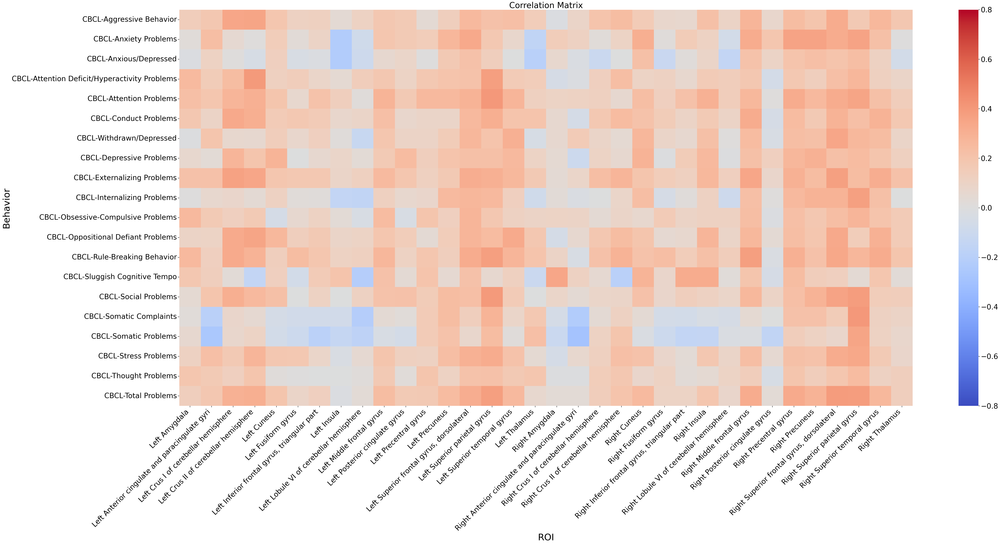

Prototype 2


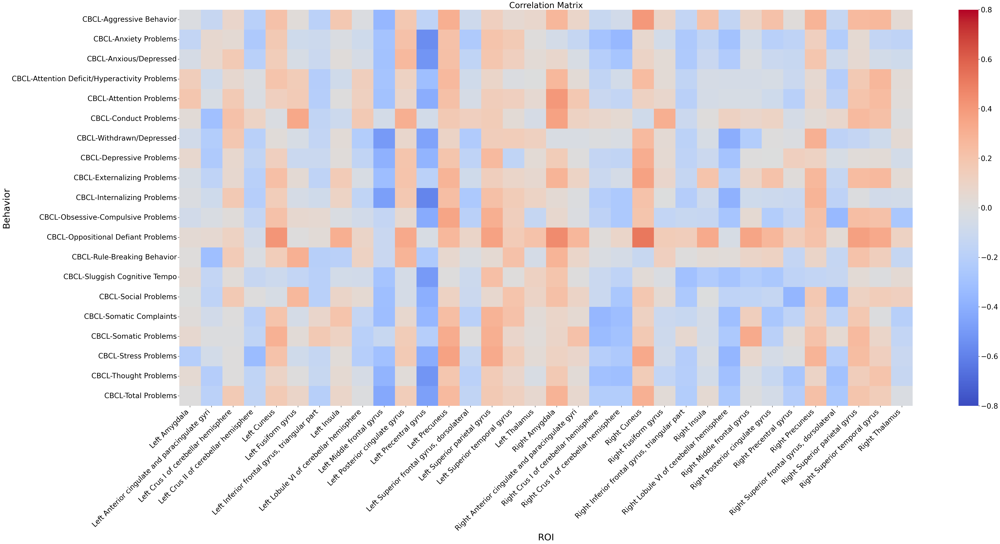

Prototype 3


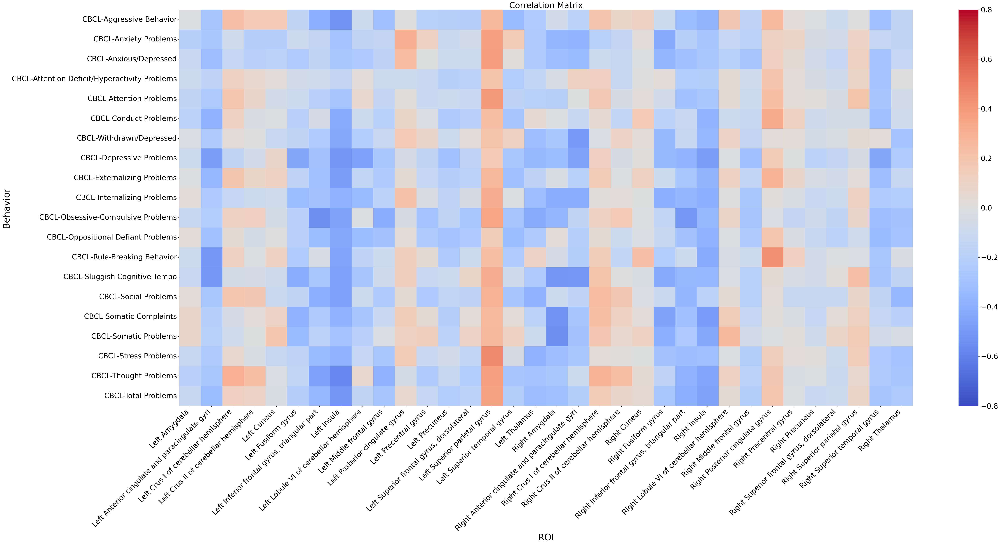

Prototype 4


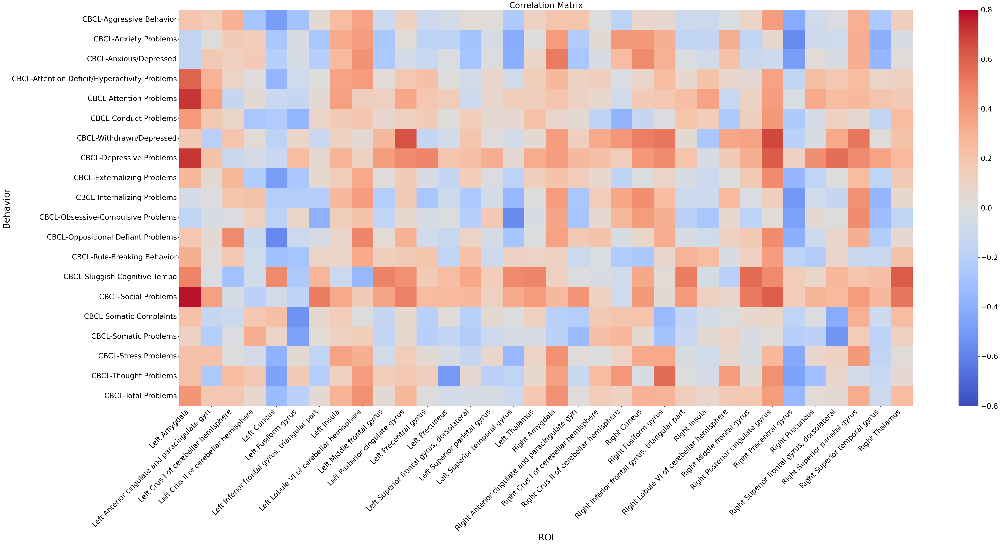

Prototype 5


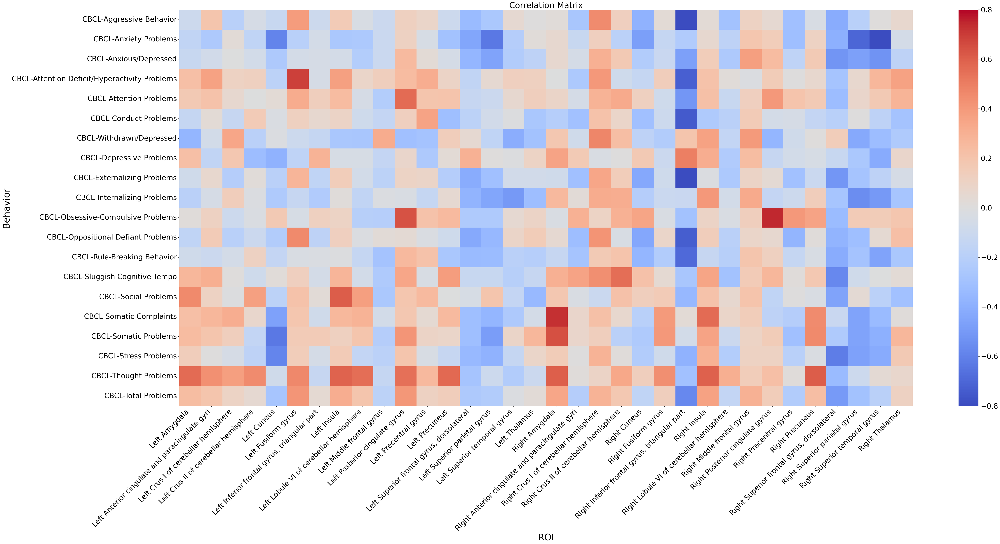

In [47]:
plot_corr_matrix(corrmatrix_prt_1, behavior_cols=behavior_cols, prt_name="Prototype 1")
plot_corr_matrix(corrmatrix_prt_2, behavior_cols=behavior_cols, prt_name="Prototype 2")
plot_corr_matrix(corrmatrix_prt_3, behavior_cols=behavior_cols, prt_name="Prototype 3")
plot_corr_matrix(corrmatrix_prt_4, behavior_cols=behavior_cols, prt_name="Prototype 4")
plot_corr_matrix(corrmatrix_prt_5, behavior_cols=behavior_cols, prt_name="Prototype 5")

### p-value Matrix

In [48]:
def plot_p_val_matrix(pmatrix_prt_1, behavior_column_map=behavior_column_map, prt_name="Prototype 1"):
    print(prt_name)
    fig, axs = plt.subplots(1,1, figsize=(55,22))
    pmax = thresh = FIVE_PERCENT
    pmin = 0.001
    log_norm = LogNorm(vmin=pmin, vmax=pmax)
    mp_prt_1 = pmatrix_prt_1.rename(index=behavior_column_map)
    significant_ps_prt_1 = mp_prt_1 < thresh

    sns.heatmap(mp_prt_1, ax=axs, annot=True,
                fmt=".3f",
                norm=log_norm,
                mask=~significant_ps_prt_1,
                # vmin=0.001, vmax=0.1,
                cmap='rocket', 
                #cbar_kws={'ticks': [0.001, 0.005, 0.01, 0.05, 0.1]
                # , 'extend':'max'}
            )
    axs.set_facecolor("seashell")
    axs.set_title(f"Raw p-values below {thresh}")
    plt.xticks(rotation=45, ha='right')
    plt.ylabel("Behavior")
    plt.xlabel("ROI")
    plt.tight_layout()
    # plt.savefig('figures/pmatrix.pdf', dpi=150)
    plt.show()

Prototype 1


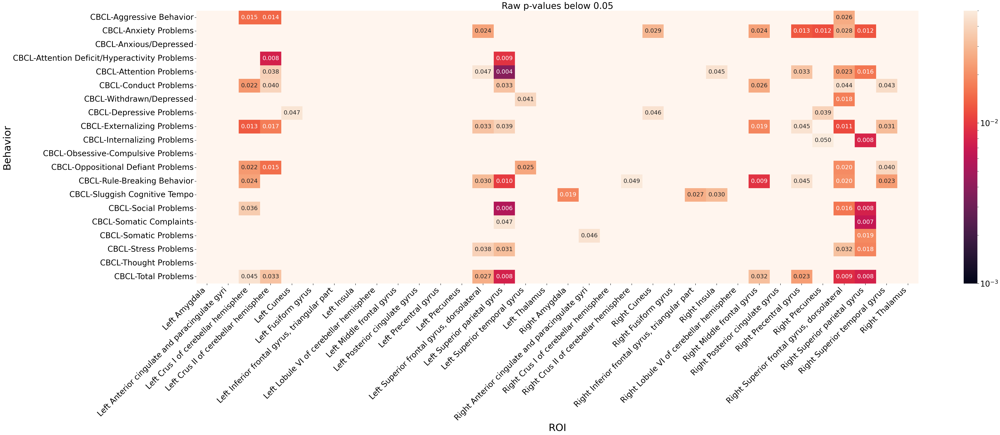

Prototype 2


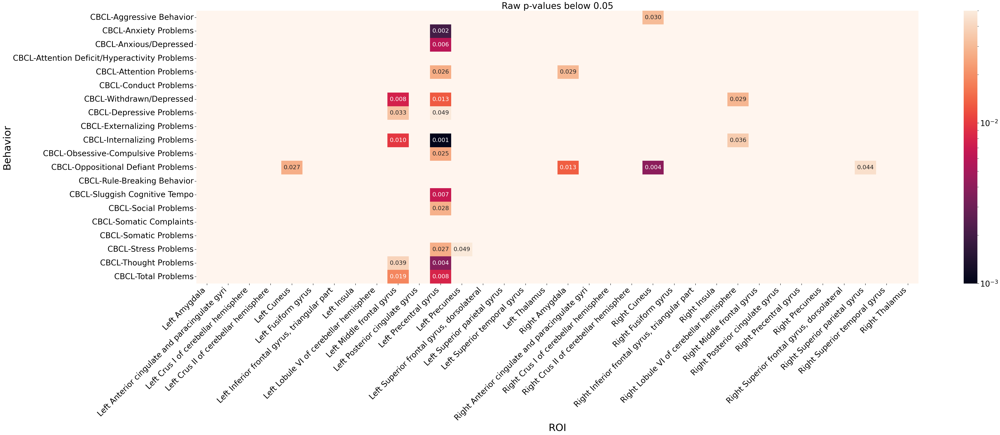

Prototype 3


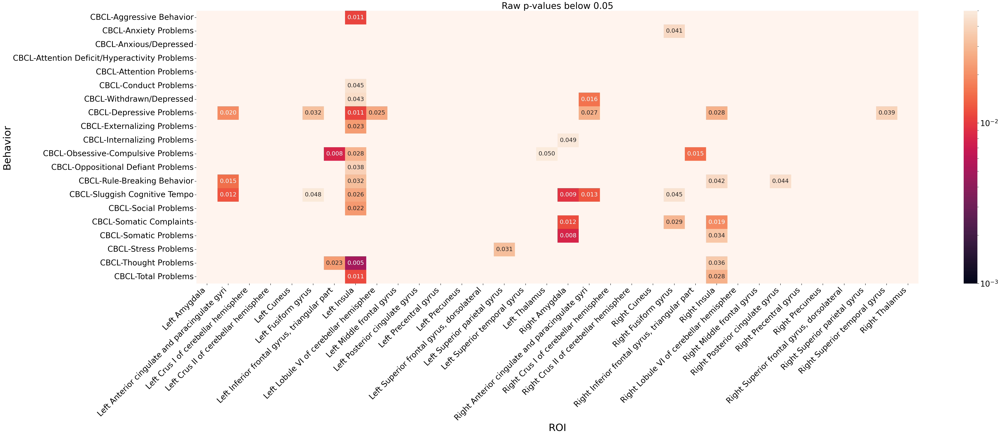

Prototype 4


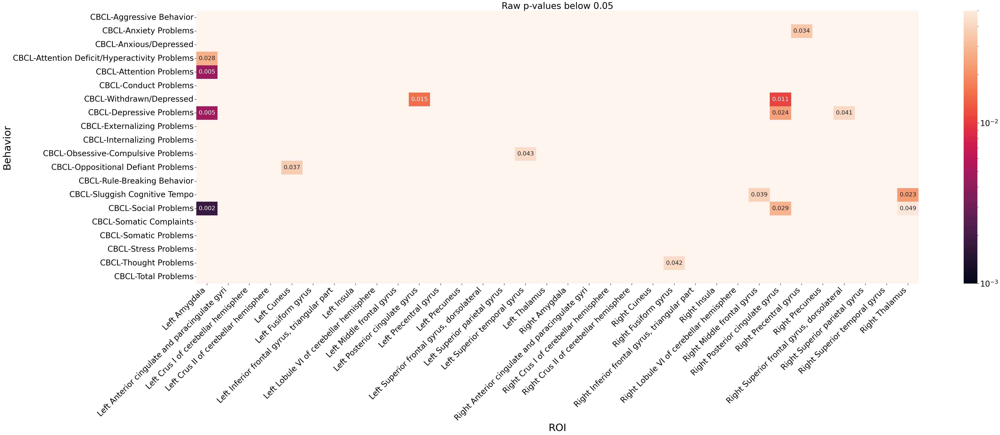

Prototype 5


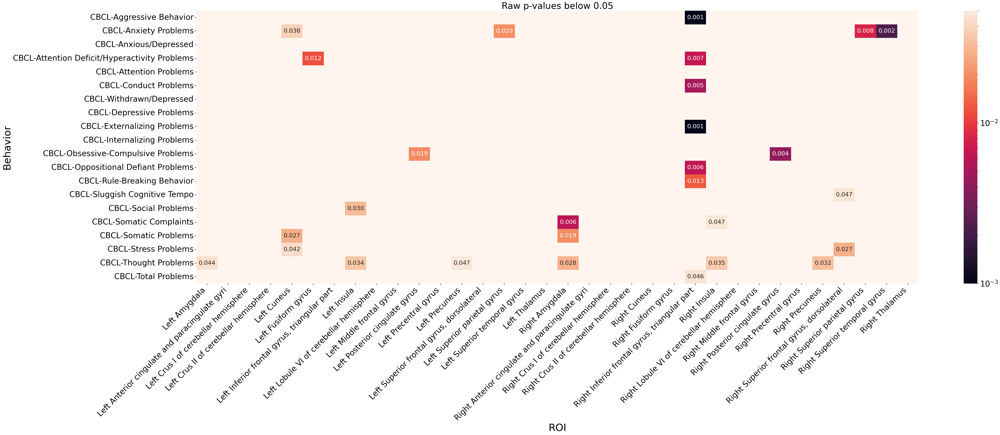

In [49]:
plot_p_val_matrix(pmatrix_prt_1, behavior_column_map=behavior_column_map, prt_name="Prototype 1")
plot_p_val_matrix(pmatrix_prt_2, behavior_column_map=behavior_column_map, prt_name="Prototype 2")
plot_p_val_matrix(pmatrix_prt_3, behavior_column_map=behavior_column_map, prt_name="Prototype 3")
plot_p_val_matrix(pmatrix_prt_4, behavior_column_map=behavior_column_map, prt_name="Prototype 4")
plot_p_val_matrix(pmatrix_prt_5, behavior_column_map=behavior_column_map, prt_name="Prototype 5")

### Significant correlations

In [50]:
def plot_significant_corr_matrix(corrmatrix_prt_1, pmatrix_prt_1, behavior_column_map=behavior_column_map, prt_name="Prototype 1"):
    print(prt_name)
    sns.set_context("notebook", font_scale=1.5, rc={"axes.labelsize": 20,
                                                    "axes.titlesize":20,
                                                    'axes.labelweight':'bold',
                                                    'xtick.labelsize': 20,
                                                    'ytick.labelsize': 20
                                                })
    thresh = FIVE_PERCENT
    significant_correlation_prt_1 = pmatrix_prt_1 < thresh * 1
    m_sig_corr_prt_1 = corrmatrix_prt_1[significant_correlation_prt_1].rename(index=behavior_column_map)

    fig, axs = plt.subplots(1,1, figsize=(40,12))
    sns.heatmap(m_sig_corr_prt_1, cmap='coolwarm', vmin=-0.75, vmax=0.75, ax=axs, annot=True, fmt='.2f',)
    axs.set_title(f"Correlations having raw p-values below {thresh}")
    plt.xticks(rotation=45, ha='right')
    plt.ylabel("Behavior")
    plt.xlabel("ROI")
    plt.tight_layout()
    # plt.savefig('figures/fivep-sig-correlation-heatmap.pdf', dpi=150)
    plt.show()
    

Prototype 1


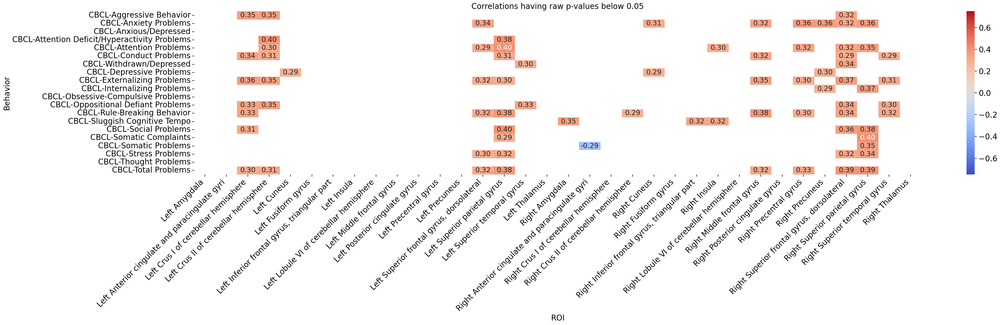

In [51]:
plot_significant_corr_matrix(corrmatrix_prt_1, pmatrix_prt_1, behavior_column_map=behavior_column_map, prt_name="Prototype 1")
# plot_significant_corr_matrix(corrmatrix_prt_2, pmatrix_prt_2, behavior_column_map=behavior_column_map, prt_name="Prototype 2")
# plot_significant_corr_matrix(corrmatrix_prt_3, pmatrix_prt_3, behavior_column_map=behavior_column_map, prt_name="Prototype 3")
# plot_significant_corr_matrix(corrmatrix_prt_4, pmatrix_prt_4, behavior_column_map=behavior_column_map, prt_name="Prototype 4")
# plot_significant_corr_matrix(corrmatrix_prt_5, pmatrix_prt_5, behavior_column_map=behavior_column_map, prt_name="Prototype 5")

### Significant correlations (adjusted-p)

In [52]:
def plot_sig_corr_matrix_adj_p(corrmatrix_prt_1, corrected_pmatrix_prt_1, behavior_column_map=behavior_column_map, prt_name="Prototype 1"):
    print(prt_name)
    fig, axs = plt.subplots(1,1, figsize=(50,15))
    thresh = FIVE_PERCENT * 9
    mm_prt_1 = corrmatrix_prt_1[corrected_pmatrix_prt_1 < thresh].rename(index=behavior_column_map)
    sns.heatmap(mm_prt_1,
                annot=True,
                cmap='coolwarm', vmin=-1, vmax=1, ax=axs,)
    axs.set_title(f"Significant Correlations (corrected-p < {thresh})")
    plt.xticks(rotation=35, ha='right')
    plt.ylabel("Behavior")
    plt.xlabel("ROI")
    plt.tight_layout()
    # plt.savefig('figures/corrected_sig_roi_corrs.pdf', dpi=150)
    plt.show()

Prototype 1


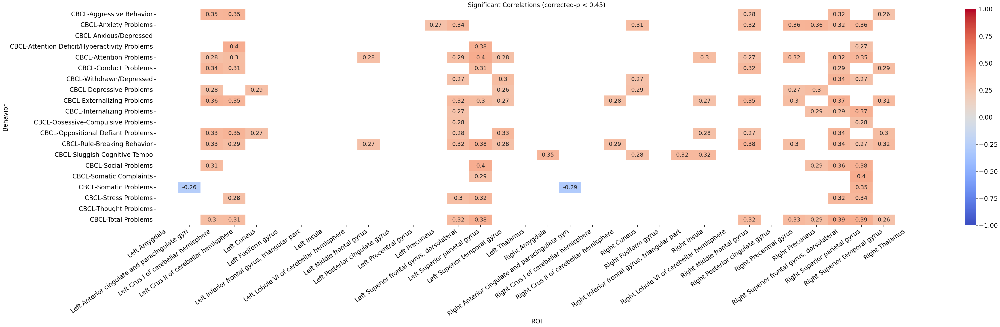

Prototype 2


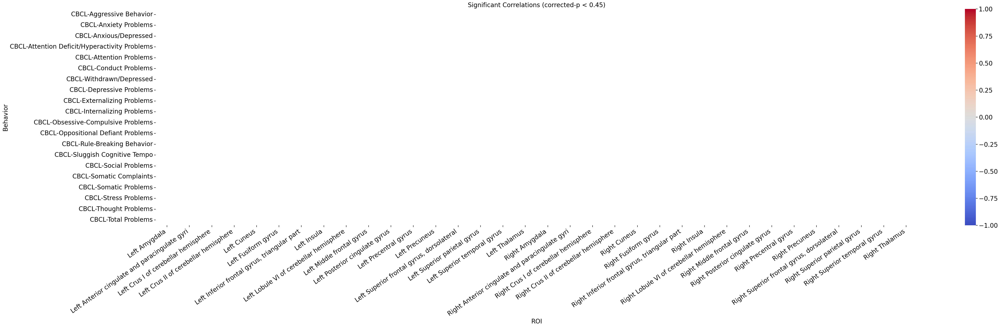

Prototype 3


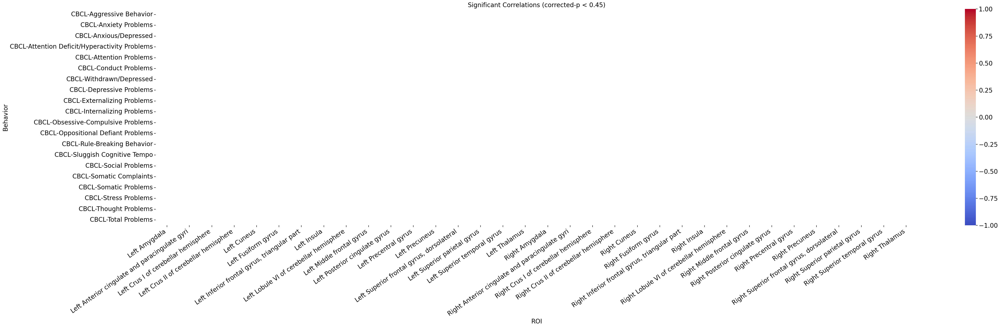

Prototype 4


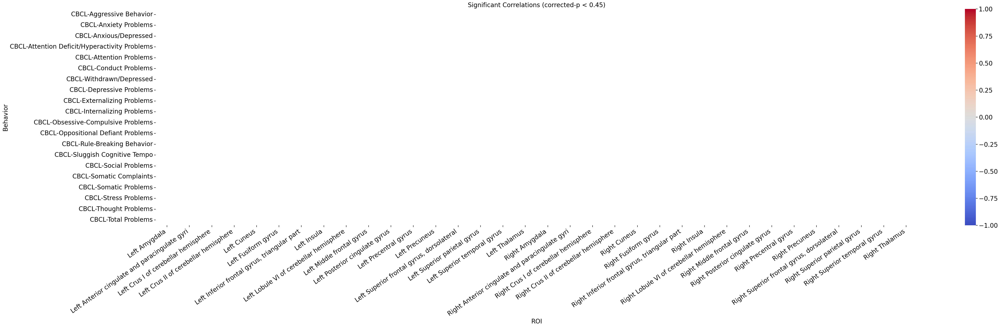

Prototype 5


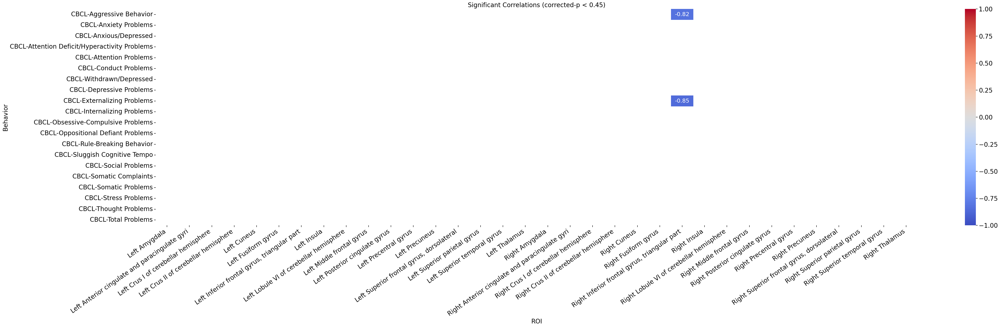

In [53]:
plot_sig_corr_matrix_adj_p(corrmatrix_prt_1, corrected_pmatrix_prt_1, behavior_column_map=behavior_column_map, prt_name="Prototype 1")
plot_sig_corr_matrix_adj_p(corrmatrix_prt_2, corrected_pmatrix_prt_2, behavior_column_map=behavior_column_map, prt_name="Prototype 2")
plot_sig_corr_matrix_adj_p(corrmatrix_prt_3, corrected_pmatrix_prt_3, behavior_column_map=behavior_column_map, prt_name="Prototype 3")
plot_sig_corr_matrix_adj_p(corrmatrix_prt_4, corrected_pmatrix_prt_4, behavior_column_map=behavior_column_map, prt_name="Prototype 4")
plot_sig_corr_matrix_adj_p(corrmatrix_prt_5, corrected_pmatrix_prt_5, behavior_column_map=behavior_column_map, prt_name="Prototype 5")

### Significant Behaviors | ROIs (Bar Plot)

In [54]:
def plot_significant_behaviors_rois(sigcorrdf_prt_1, prt_name="Prototype 1"):
    print(prt_name)
    thresh = FIVE_PERCENT * 8
    fig, axs = plt.subplots(1,2, figsize=(50,6))

    thresh = 0.05
    relcorrs = sigcorrdf_prt_1[sigcorrdf_prt_1['p-value'] < thresh]
    relcorrs.groupby('Behavior')['ROI'].count().sort_values(ascending=True).plot(kind='barh', ax=axs[0])

    axs[0].set_title(f"Count of Significant Behaviors (p-value < {thresh})")
    # plt.xticks(rotation=45, ha='right');

    relcorrs.groupby('ROI')['Behavior'].count().sort_values(ascending=True).plot(kind='barh', ax=axs[1])
    axs[1].set_title(f"Count of Significant ROIs (p-value < {thresh})")
    # axs[1].set_xticks(rotation=45, ha='right');
    plt.tight_layout()
    # plt.title("Number Behavior/ROIs in a Significant Pair")
    plt.show()

Prototype 1


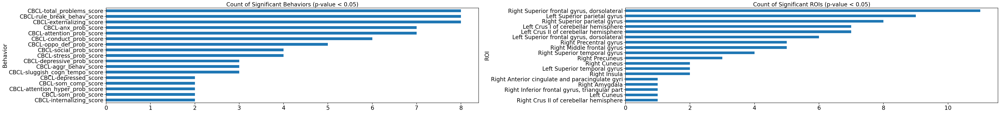

In [55]:
plot_significant_behaviors_rois(sigcorrdf_prt_1, prt_name="Prototype 1")
# plot_significant_behaviors_rois(sigcorrdf_prt_2, prt_name="Prototype 2")
# plot_significant_behaviors_rois(sigcorrdf_prt_3, prt_name="Prototype 3")
# plot_significant_behaviors_rois(sigcorrdf_prt_4, prt_name="Prototype 4")
# plot_significant_behaviors_rois(sigcorrdf_prt_5, prt_name="Prototype 5")

In [56]:
thresh = FIVE_PERCENT
mm_prt_1 = corrmatrix_prt_1[pmatrix_prt_1 < thresh].rename(index=behavior_column_map)
mm_prt_1.loc[:,'Left Cuneus'].sort_values()

Behavior
CBCL-Depressive Problems                         0.285502
CBCL-Aggressive Behavior                              NaN
CBCL-Anxiety Problems                                 NaN
CBCL-Anxious/Depressed                                NaN
CBCL-Attention Deficit/Hyperactivity Problems         NaN
CBCL-Attention Problems                               NaN
CBCL-Conduct Problems                                 NaN
CBCL-Withdrawn/Depressed                              NaN
CBCL-Externalizing Problems                           NaN
CBCL-Internalizing Problems                           NaN
CBCL-Obsessive-Compulsive Problems                    NaN
CBCL-Oppositional Defiant Problems                    NaN
CBCL-Rule-Breaking Behavior                           NaN
CBCL-Sluggish Cognitive Tempo                         NaN
CBCL-Social Problems                                  NaN
CBCL-Somatic Complaints                               NaN
CBCL-Somatic Problems                                 NaN
CBCL-

In [57]:
mmt_prt_1 = corrmatrix_prt_1[pmatrix_prt_1 < thresh]
mmt_prt_2 = corrmatrix_prt_2[pmatrix_prt_2 < thresh]
mmt_prt_3 = corrmatrix_prt_3[pmatrix_prt_3 < thresh]
mmt_prt_4 = corrmatrix_prt_4[pmatrix_prt_4 < thresh]
mmt_prt_5 = corrmatrix_prt_5[pmatrix_prt_5 < thresh]

In [58]:
PATH_prototypes_hier = "ghsom_outputs/bmus/abcd_asd_prototypes_ghsom_5x3_leaf_v10_hier.csv"
asd_prototypes_hier = pd.read_csv(PATH_prototypes_hier,index_col=0)
asd_prototypes_hier

,Input Index,Position List,Identifier,Input Label,Label Name,BMU Distance
0,237,"[(0, 0), (0, 0)]",NDARINV0182J779,5,ABCD-ASD,1.236225
1,251,"[(0, 0), (0, 0)]",NDARINV2GAAH0E9,5,ABCD-ASD,2.864446
22,291,"[(0, 0), (0, 1)]",NDARINVAD8N7RW7,5,ABCD-ASD,1.399339
23,317,"[(0, 0), (1, 1)]",NDARINVE1DC53WA,5,ABCD-ASD,1.322025
24,395,"[(0, 0), (1, 1)]",NDARINVZFG1AXUD,5,ABCD-ASD,0.885778
...,...,...,...,...,...,...
653,318,"[(2, 1), (4, 3)]",NDARINVEBFULY5Y,5,ABCD-ASD,0.470068
654,351,"[(2, 1), (4, 3)]",NDARINVL70MDV52,5,ABCD-ASD,0.816679
655,386,"[(2, 1), (4, 2)]",NDARINVYEZ6T0J8,5,ABCD-ASD,1.646633
658,256,"[(2, 1), (3, 1)]",NDARINV2VY7YYNW,5,ABCD-ASD,0.980403


In [59]:
asd_prototypes_hier = asd_prototypes_hier[asd_prototypes_hier['Identifier'].isin(intersection_ids)]
asd_prototypes_hier.shape

(160, 6)

In [60]:
asdsamples.head()

,ID,Left Precentral gyrus,Right Precentral gyrus,"Left Superior frontal gyrus, dorsolateral","Right Superior frontal gyrus, dorsolateral",Left Middle frontal gyrus,Right Middle frontal gyrus,"Left Inferior frontal gyrus, triangular part","Right Inferior frontal gyrus, triangular part",Left Insula,...,CBCL-obsessive_comp_prob_score,CBCL-oppo_def_prob_score,CBCL-rule_break_behav_score,CBCL-sluggish_cogn_tempo_score,CBCL-social_prob_score,CBCL-som_comp_score,CBCL-som_prob_score,CBCL-stress_prob_score,CBCL-thought_prob_score,CBCL-total_problems_score
0,NDARINVD0KNT1VK,-26.278432,-24.267631,-22.470721,-20.551572,-25.812518,-26.332269,-23.572781,-27.598060,-25.678417,...,3.0,1.0,0.0,0.0,3.0,1.0,1.0,4.0,4.0,20.0
1,NDARINVNHL7P38J,-28.900940,-27.339915,-24.444127,-24.348298,-24.973602,-21.193840,-22.676390,-24.479113,-29.755071,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,NDARINV0182J779,-25.193068,-28.874346,-21.369676,-24.444685,-22.587843,-23.116134,-21.751412,-24.706743,-27.839014,...,3.0,3.0,2.0,1.0,3.0,1.0,0.0,6.0,5.0,29.0
3,NDARINV03KMHMJJ,-27.401375,-31.332295,-24.389794,-26.534896,-24.013445,-26.252658,-20.525813,-25.187548,-24.647947,...,0.0,3.0,2.0,0.0,0.0,6.0,3.0,5.0,1.0,28.0
4,NDARINV09AUXBBT,-28.916884,-27.614515,-25.057475,-26.091518,-24.222384,-24.909933,-24.975833,-27.337407,-29.274218,...,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,8.0


In [61]:
asd_prototypes.head()

,bmu,ID
0,0,NDARINV0182J779
1,0,NDARINV2GAAH0E9
2,0,NDARINVAD8N7RW7
3,0,NDARINVE1DC53WA
4,0,NDARINVZFG1AXUD


### Display with a pair

In [62]:
# Filter significant correlations from the matrix `mmt`
significant_pairs = mmt_prt_1.stack(dropna=True).reset_index()
significant_pairs.columns = ['Behavior', 'ROI', 'Correlation']

# Sort by absolute correlation values
significant_pairs['abs_corr'] = significant_pairs['Correlation'].abs()
sorted_pairs = significant_pairs.sort_values(by='abs_corr', ascending=False)

# Total number of significant correlations
total_combinations = len(sorted_pairs)

/tmp/ipykernel_501200/972269050.py:2: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  significant_pairs = mmt_prt_1.stack(dropna=True).reset_index()


### Display top correlations

In [63]:
from matplotlib.lines import Line2D
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import spearmanr, rankdata

def plot_pheno_correlations(
    mmt_prt: pd.DataFrame,
    pmatrix_prt: pd.DataFrame,
    samples_df: pd.DataFrame,
    prototypes_hier_df: pd.DataFrame,
    behavior_column_map: dict,
    top_pairs_n: int = 5,
    num_protos: int = 5,
    fig_width: float = 7,
    fig_height_per: float = 5
):
    """
    Plot the top N phenotype vs ROI correlations for a given mmt_prt matrix.
    
    Parameters
    ----------
    mmt_prt : DataFrame
        DataFrame of correlation values (behaviors × ROIs).
    pmatrix_prt : DataFrame
        Corresponding p-value matrix.
    samples_df : DataFrame
        Your sample-level DataFrame (must have 'ID' and behavior columns).
    prototypes_hier_df : DataFrame
        Prototype hierarchy with columns ['Identifier','Position List','BMU Distance'].
    behavior_column_map : dict
        Maps behavior codes to human-readable names.
    top_pairs_n : int
        Number of top correlations to plot vertically.
    num_protos : int
        Number of top prototypes (Level 1) to highlight.
    fig_width : float
        Width of each subplot.
    fig_height_per : float
        Height per subplot.
    """
    # --- prepare correlation table ---
    sig = mmt_prt.stack(future_stack=True).reset_index()
    sig.columns = ['Behavior','ROI','Correlation']
    sig = sig.dropna(subset=['Correlation'])
    sig['abs_corr'] = sig['Correlation'].abs()
    sig = sig.sort_values('abs_corr', ascending=False)
    sig['p_value'] = [
        pmatrix_prt.loc[b, r]
        for b, r in zip(sig['Behavior'], sig['ROI'])
    ]
    total = len(sig)
    top_n = min(top_pairs_n, total)
    top_pairs = sig.head(top_n)

    # --- parse prototypes hierarchy ---
    def parse_pos(s):
        lst = eval(s)
        return (lst[0], lst[1] if len(lst)>1 else None)
    prototypes_hier_df = prototypes_hier_df.copy()
    prototypes_hier_df['Level 1'], prototypes_hier_df['Level 2'] = zip(
        *prototypes_hier_df['Position List'].apply(parse_pos)
    )
    hier = prototypes_hier_df[['Identifier','Level 1','Level 2','BMU Distance']]
    rowdf = pd.merge(samples_df, hier,
                     left_on='ID', right_on='Identifier', how='left')

    # --- order categories by frequency ---
    lvl1_counts = rowdf['Level 1'].value_counts()
    lvl2_counts = rowdf['Level 2'].value_counts()
    rowdf['Level 1'] = pd.Categorical(
        rowdf['Level 1'], categories=lvl1_counts.index, ordered=True
    )
    rowdf['Level 2'] = pd.Categorical(
        rowdf['Level 2'], categories=lvl2_counts.index, ordered=True
    )

    # --- choose top Level1 prototypes & palette/markers ---
    top_lvl1 = lvl1_counts.head(num_protos).index
    palette    = sns.color_palette("tab10", n_colors=num_protos)
    lvl1_colors = {lvl: palette[i] for i, lvl in enumerate(top_lvl1)}
    markers    = ['o','s','^','D','P','X','v','*','p','<','>','h','H','d','8']
    lvl2_markers = {
        lvl2: markers[i % len(markers)]
        for i, lvl2 in enumerate(lvl2_counts.index)
    }

    # --- prepare figure ---
    fig, axes = plt.subplots(top_n, 1, figsize=(fig_width, fig_height_per*top_n))
    if top_n == 1:
        axes = [axes]

    for ax, pair in zip(axes, top_pairs.itertuples(index=False)):
        beh, roi, corr, pval = pair.Behavior, pair.ROI, pair.Correlation, pair.p_value

        # rank‐transform data
        df = rowdf[rowdf[beh] > -1].copy()
        df[[roi, beh]] = df[[roi, beh]].apply(rankdata)

        # build balanced sample across top prototypes
        groups = [df[df['Level 1']==lvl] for lvl in top_lvl1]
        max_sz = max(len(g) for g in groups)
        balanced = pd.concat(
            g if len(g)==max_sz
            else pd.concat([g, g.sample(n=max_sz-len(g), replace=True)])
            for g in groups
        )

        # scatter points
        scatters = []
        for lvl1 in top_lvl1:
            sub1 = df[df['Level 1']==lvl1]
            for lvl2 in lvl2_counts.index:
                sub2 = sub1[sub1['Level 2']==lvl2]
                if sub2.empty:
                    continue
                sc = ax.scatter(
                    sub2[roi], sub2[beh],
                    label=f"L1={lvl1}, L2={lvl2}",
                    color=lvl1_colors[lvl1],
                    marker=lvl2_markers[lvl2],
                    s=80, alpha=0.8,
                    edgecolor=lvl1_colors[lvl1]
                )
                scatters.append(sc)

        # regression lines
        for lvl1 in top_lvl1:
            sns.regplot(
                x=roi, y=beh,
                data=df[df['Level 1']==lvl1],
                scatter=False,
                color=lvl1_colors[lvl1],
                ax=ax,
                line_kws={'linewidth':1.5}
            )
        sns.regplot(
            x=roi, y=beh,
            data=balanced,
            scatter=False,
            color='black',
            ax=ax,
            line_kws={'linestyle':'--','linewidth':1.5}
        )

        # compute & annotate Spearman ρ
        rho = {lvl: spearmanr(df[df['Level 1']==lvl][roi],
                              df[df['Level 1']==lvl][beh])[0]
               for lvl in top_lvl1}
        rho_bal = spearmanr(balanced[roi], balanced[beh])[0]
        y0, dy = 1.02, 0.05
        for i, lvl in enumerate(top_lvl1):
            ax.text(1.02, y0 - i*dy,
                    f"{lvl}: {rho[lvl]:.2f}",
                    transform=ax.transAxes,
                    color=lvl1_colors[lvl],
                    fontsize=9)
        ax.text(1.02, y0 - num_protos*dy,
                f"Balanced: {rho_bal:.2f}",
                transform=ax.transAxes,
                color='black',
                fontsize=9)

        # legends
        ax.legend(
            handles=scatters,
            title="L1 & L2",
            bbox_to_anchor=(1.02,1),
            loc='upper left',
            fontsize=8
        )
        proto_handles = [
            Line2D([0],[0], marker='o', color=lvl1_colors[lvl], linestyle='',
                   label=str(lvl))
            for lvl in top_lvl1
        ] + [Line2D([0],[0], color='black', linestyle='--',
                    label='Balanced')]
        ax.legend(
            handles=proto_handles,
            #title="Prototypes",
            bbox_to_anchor=(1.02,0.3),
            loc='upper left',
            fontsize=8
        )

        # labels & title
        ax.set_xlabel(roi, fontsize=11)
        ax.set_ylabel(behavior_column_map.get(beh, beh), fontsize=11)
        ax.set_title(
            #f"{behavior_column_map.get(beh,beh)} vs {roi}  "
            f"(Corr={corr:.2f}, p={pval:.3f})",
            fontsize=12
        )
        ax.tick_params(labelsize=10)

    plt.tight_layout()
    plt.show()

PROTOYPE 1


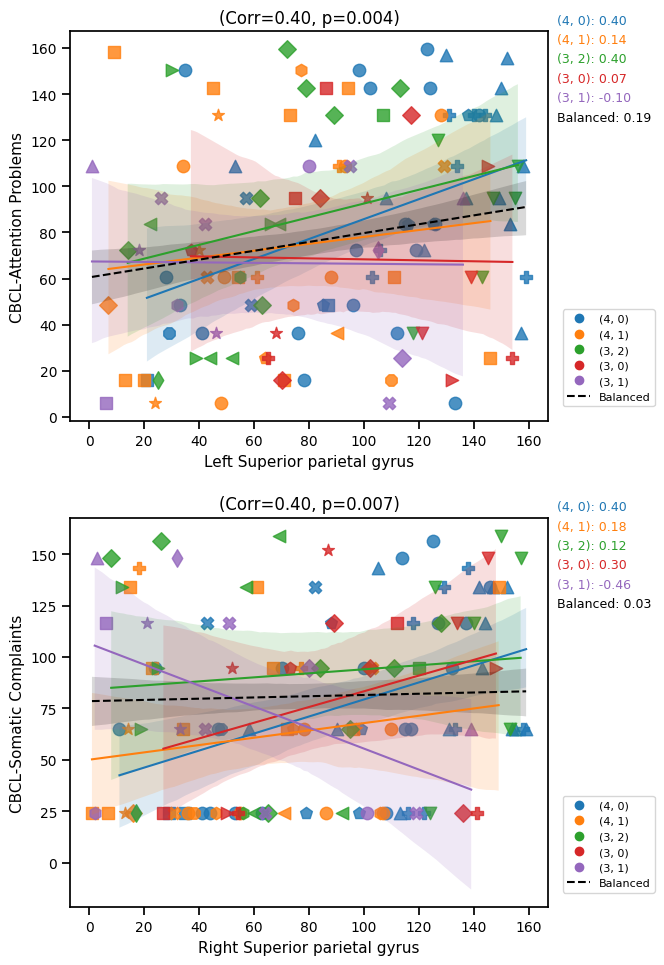

In [64]:
print("PROTOYPE 1")
plot_pheno_correlations(mmt_prt_1, pmatrix_prt_1,
                        asdsamples, asd_prototypes_hier,
                        behavior_column_map,
                        top_pairs_n=2, num_protos=5)

PROTOYPE 2


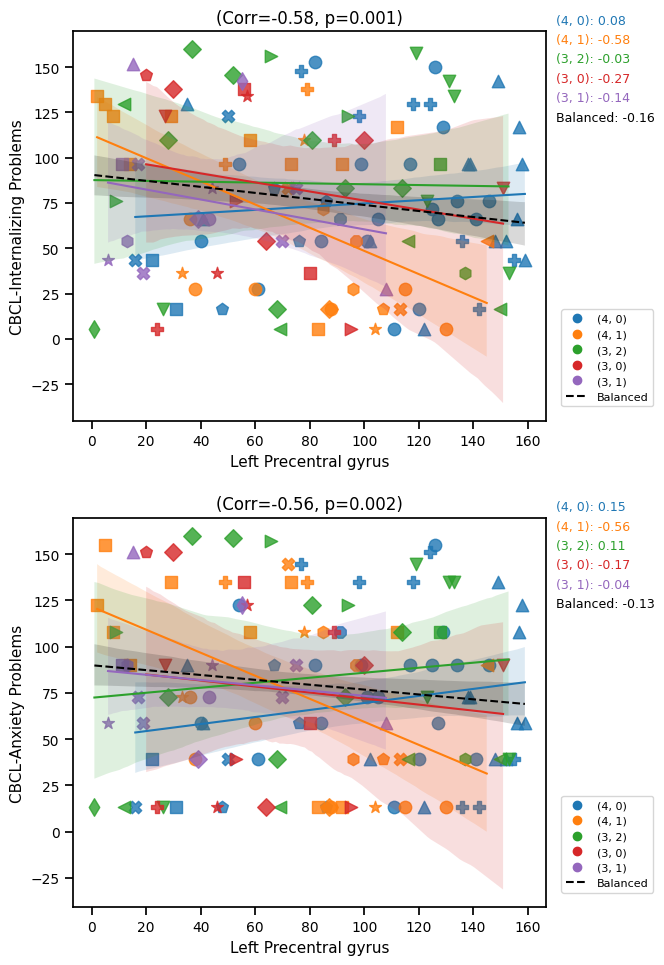

In [65]:
print("PROTOYPE 2")
plot_pheno_correlations(mmt_prt_2, pmatrix_prt_2,
                        asdsamples, asd_prototypes_hier,
                        behavior_column_map,
                        top_pairs_n=2, num_protos=5)

PROTOYPE 3


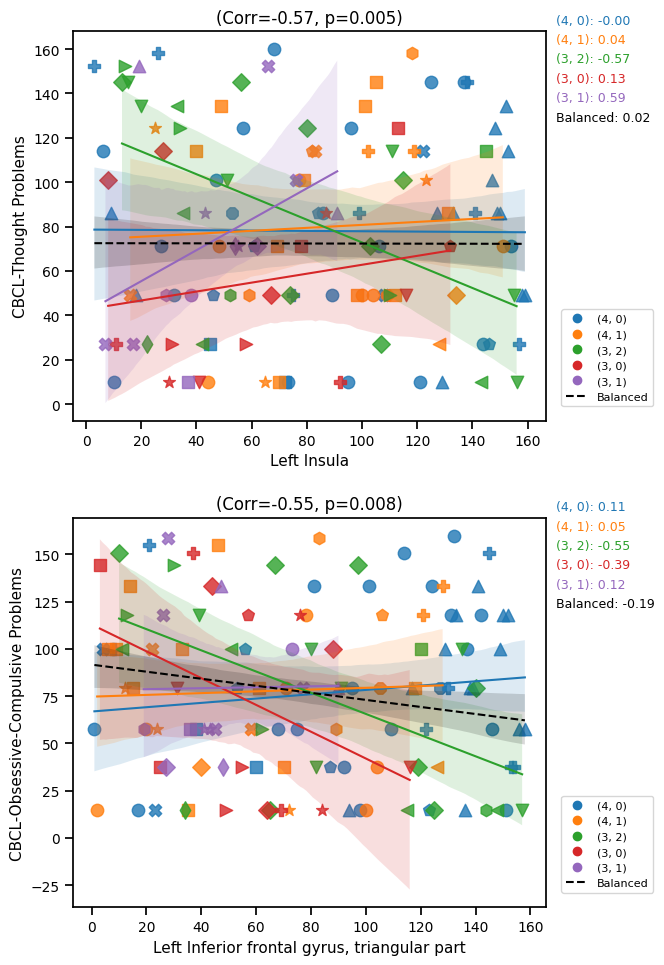

In [66]:
print("PROTOYPE 3")
plot_pheno_correlations(mmt_prt_3, pmatrix_prt_3,
                        asdsamples, asd_prototypes_hier,
                        behavior_column_map,
                        top_pairs_n=2, num_protos=5)

PROTOYPE 4


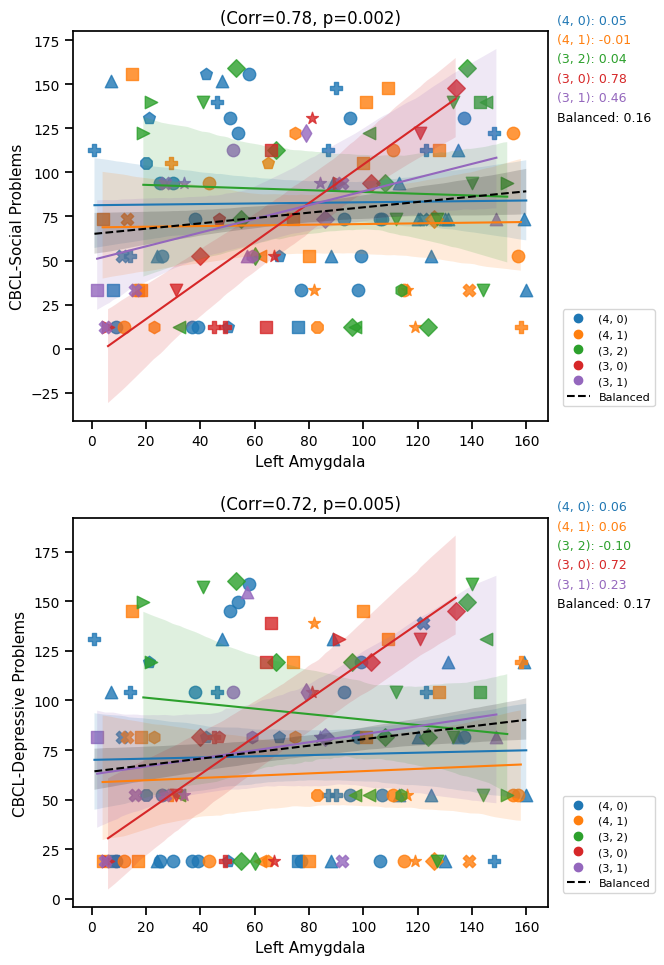

In [67]:
print("PROTOYPE 4")
plot_pheno_correlations(mmt_prt_4, pmatrix_prt_4,
                        asdsamples, asd_prototypes_hier,
                        behavior_column_map,
                        top_pairs_n=2, num_protos=5)

PROTOYPE 5


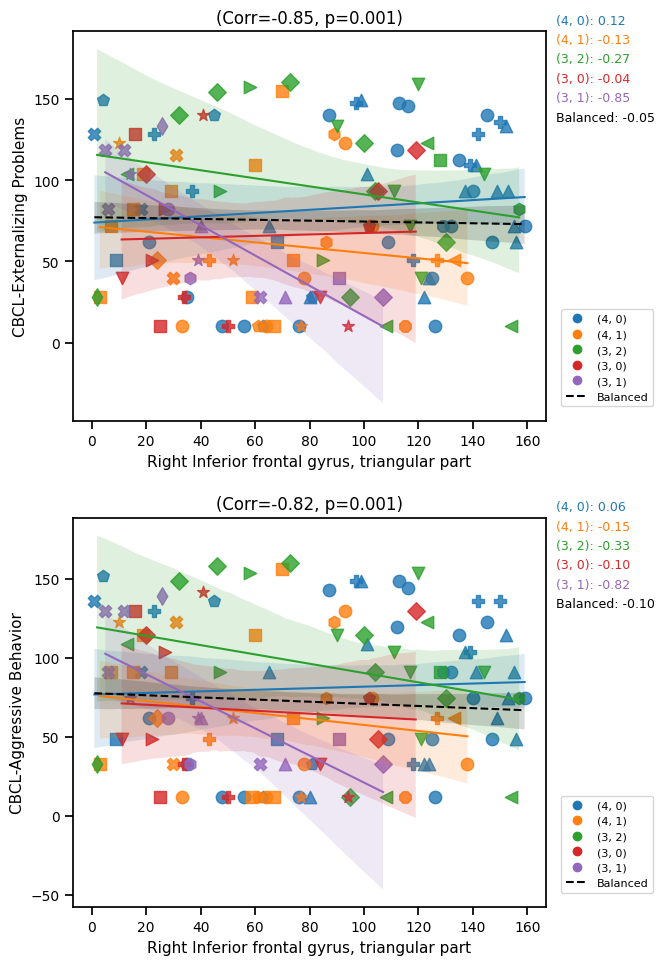

In [68]:
print("PROTOYPE 5")
plot_pheno_correlations(mmt_prt_5, pmatrix_prt_5,
                        asdsamples, asd_prototypes_hier,
                        behavior_column_map,
                        top_pairs_n=2, num_protos=5)

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from scipy.stats import rankdata
import pandas as pd

def plot_proto_top5_samples(
    mmt_prt: pd.DataFrame,
    pmatrix_prt: pd.DataFrame,
    samples_df: pd.DataFrame,
    prototypes_hier_df: pd.DataFrame,
    behavior_column_map: dict,
    top_pairs_n: int = 1,
    top_protos_n: int = 5,
    proto_rank: int = 0
):
    """
    Plot the top N correlations for one phenotype,
    show only the samples from the first `top_protos_n` prototypes,
    and draw the regression line for the `proto_rank`-th most frequent prototype.
    Adds two legends: one mapping prototypes → colors, and another showing displayed/total counts.
    """
    # 1. Prepare correlation table
    sig = (
        mmt_prt
        .stack(future_stack=True)
        .reset_index()
        .rename(columns={'level_0':'Behavior','level_1':'ROI', 0:'Correlation'})
    )
    sig = sig.dropna(subset=['Correlation'])
    sig['abs_corr'] = sig['Correlation'].abs()
    sig = sig.sort_values('abs_corr', ascending=False)
    sig['p_value'] = [
        pmatrix_prt.loc[b, r] for b, r in zip(sig['Behavior'], sig['ROI'])
    ]
    top_pairs = sig.head(min(top_pairs_n, len(sig)))

    # 2. Parse hierarchy
    ph = prototypes_hier_df.copy()
    ph['Level 1'], ph['Level 2'] = zip(*ph['Position List'].apply(
        lambda s: (eval(s)[0], eval(s)[1] if len(eval(s))>1 else None)
    ))

    # 3. Merge samples and restrict to top prototypes
    df = samples_df.merge(
        ph[['Identifier','Level 1','Level 2']],
        left_on='ID', right_on='Identifier', how='left'
    )
    top_lvl1 = df['Level 1'].value_counts().head(top_protos_n).index.tolist()
    df = df[df['Level 1'].isin(top_lvl1)].copy()

    # 4. Build color & marker maps
    lvl2_counts = df['Level 2'].value_counts()
    palette = sns.color_palette("tab10", n_colors=len(top_lvl1))
    level1_colors = {lvl: palette[i] for i, lvl in enumerate(top_lvl1)}
    markers = ['o','s','^','D','P','X','v','*','p','<','>','h','H','d','8']
    # ← use modulo here to avoid IndexError
    level2_markers = {
        lvl2: markers[i % len(markers)]
        for i, lvl2 in enumerate(lvl2_counts.index)
    }

    # 5. Plot setup
    fig, axes = plt.subplots(len(top_pairs), 1, figsize=(6, 4*len(top_pairs)))
    if len(top_pairs) == 1:
        axes = [axes]

    # 6. Loop over top correlations
    for ax, row in zip(axes, top_pairs.itertuples(index=False)):
        beh, roi, corr, pval = row.Behavior, row.ROI, row.Correlation, row.p_value

        # prepare data for this behavior
        sub = df[df[beh] > -1].copy()
        sub[[roi, beh]] = sub[[roi, beh]].apply(rankdata)

        # scatter all points
        for lvl1 in top_lvl1:
            grp1 = sub[sub['Level 1']==lvl1]
            for lvl2 in lvl2_counts.index:
                grp2 = grp1[grp1['Level 2']==lvl2]
                if grp2.empty:
                    continue
                ax.scatter(
                    grp2[roi], grp2[beh],
                    color=level1_colors[lvl1],
                    marker=level2_markers[lvl2],
                    s=60, alpha=0.8,
                    edgecolor=level1_colors[lvl1]
                )

        # choose prototype of interest
        local = sub['Level 1'].value_counts().index.tolist()
        choice = local[proto_rank] if proto_rank < len(local) else local[0]

        # regression for chosen prototype
        proto_df = sub[sub['Level 1']==choice]
        sns.regplot(
            x=roi, y=beh,
            data=proto_df,
            scatter=False,
            color=level1_colors[choice],
            ax=ax,
            line_kws={'linewidth':1.5}
        )

        # labels and title
        ax.set_title(f"corr={corr:.2f}, p={pval:.5f}", fontsize=10)
        ax.set_xlabel(roi,   fontsize=10)
        ax.set_ylabel(behavior_column_map.get(beh, beh), fontsize=10)
        ax.tick_params(labelsize=8)

        # legend 1: prototype colors
        proto_handles = [
            Line2D([0],[0], marker='o', color=level1_colors[lvl],
                   linestyle='', markersize=8, label=str(lvl))
            for lvl in top_lvl1
        ]
        leg1 = ax.legend(
            handles=proto_handles,
            bbox_to_anchor=(1.02, 1), loc='upper left',
            frameon=False, fontsize=9
        )
        ax.add_artist(leg1)

        # legend 2: counts displayed/total
        count_handles = []
        for lvl in top_lvl1:
            total = df[df['Level 1']==lvl].shape[0]
            displayed = sub[sub['Level 1']==lvl].shape[0]
            label = f"{lvl}: {displayed}/{total}"
            count_handles.append(Line2D([], [], linestyle='', marker='', label=label))
        ax.legend(
            handles=count_handles,
            bbox_to_anchor=(0.94, 0.50), loc='upper left',
            frameon=False, fontsize=9
        )

        ax.tick_params(labelsize=10)
        for spine in ax.spines.values():
            spine.set_linewidth(0.5)

    plt.tight_layout()
    plt.show()

PROTOYPE 1


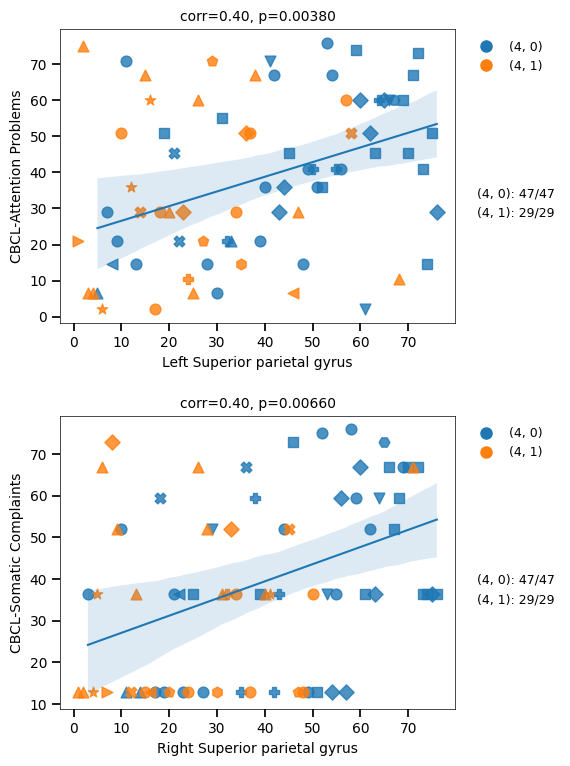

In [70]:
print("PROTOYPE 1")
plot_proto_top5_samples(
    mmt_prt   = mmt_prt_1,
    pmatrix_prt = pmatrix_prt_1,
    samples_df   = asdsamples,
    prototypes_hier_df = asd_prototypes_hier,
    behavior_column_map = behavior_column_map,
    top_pairs_n  = 2,
    top_protos_n = 2,
    proto_rank   = 0
)

PROTOYPE 2


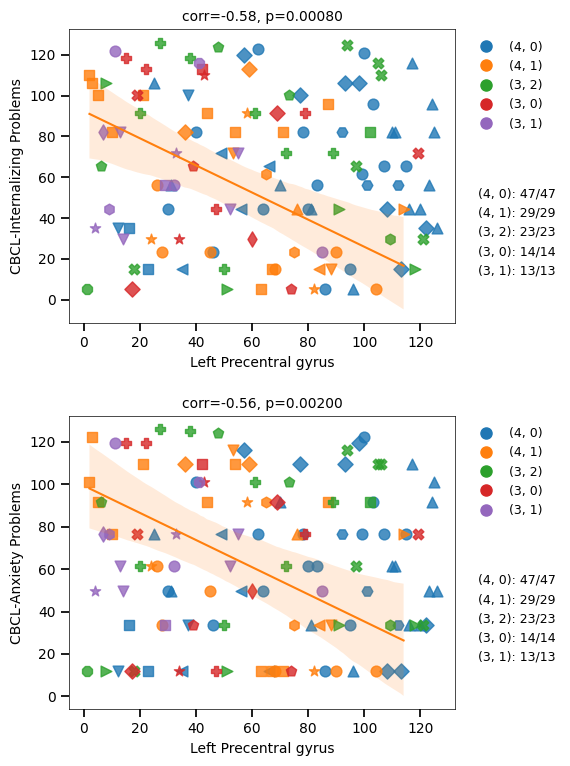

In [71]:
print("PROTOYPE 2")
plot_proto_top5_samples(
    mmt_prt   = mmt_prt_2,
    pmatrix_prt = pmatrix_prt_2,
    samples_df   = asdsamples,
    prototypes_hier_df = asd_prototypes_hier,
    behavior_column_map = behavior_column_map,
    top_pairs_n  = 2,
    top_protos_n = 5,
    proto_rank   = 1
)

PROTOYPE 3


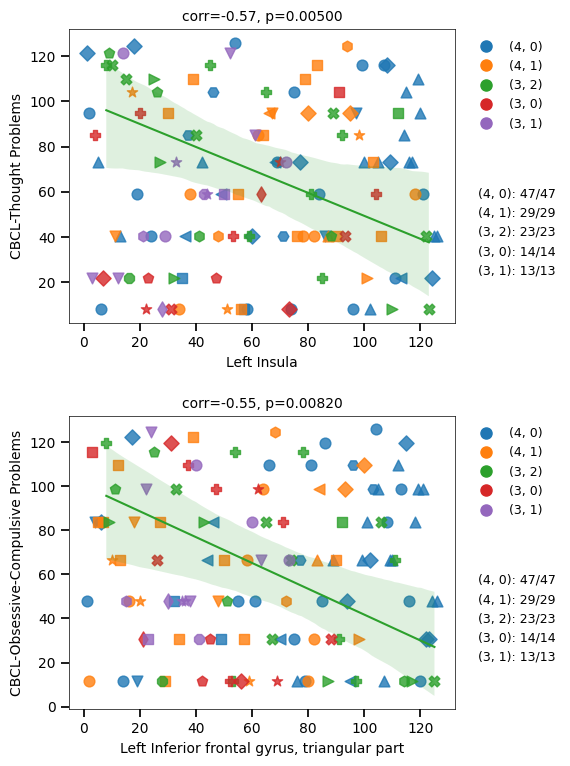

In [72]:
print("PROTOYPE 3")
plot_proto_top5_samples(
    mmt_prt   = mmt_prt_3,
    pmatrix_prt = pmatrix_prt_3,
    samples_df   = asdsamples,
    prototypes_hier_df = asd_prototypes_hier,
    behavior_column_map = behavior_column_map,
    top_pairs_n  = 2,
    top_protos_n = 5,
    proto_rank   = 2
)

PROTOYPE 4


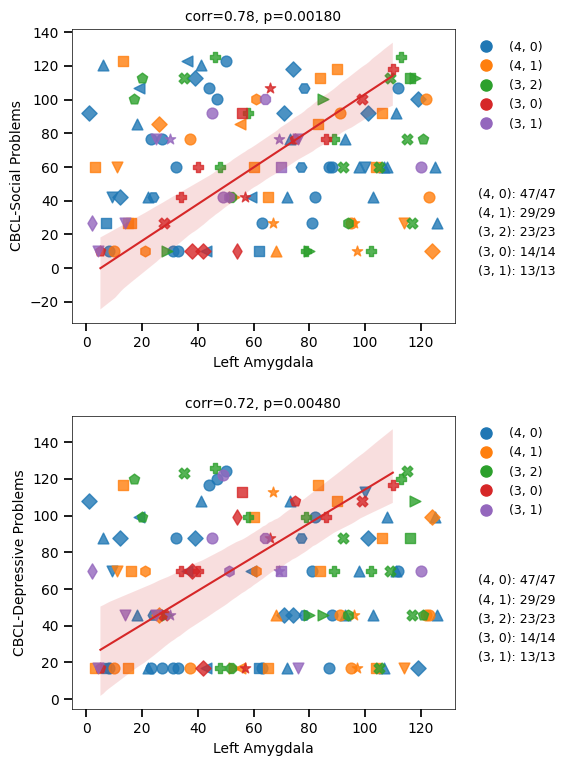

In [73]:
print("PROTOYPE 4")
plot_proto_top5_samples(
    mmt_prt   = mmt_prt_4,
    pmatrix_prt = pmatrix_prt_4,
    samples_df   = asdsamples,
    prototypes_hier_df = asd_prototypes_hier,
    behavior_column_map = behavior_column_map,
    top_pairs_n  = 2,
    top_protos_n = 5,
    proto_rank   = 3
)

PROTOYPE 5


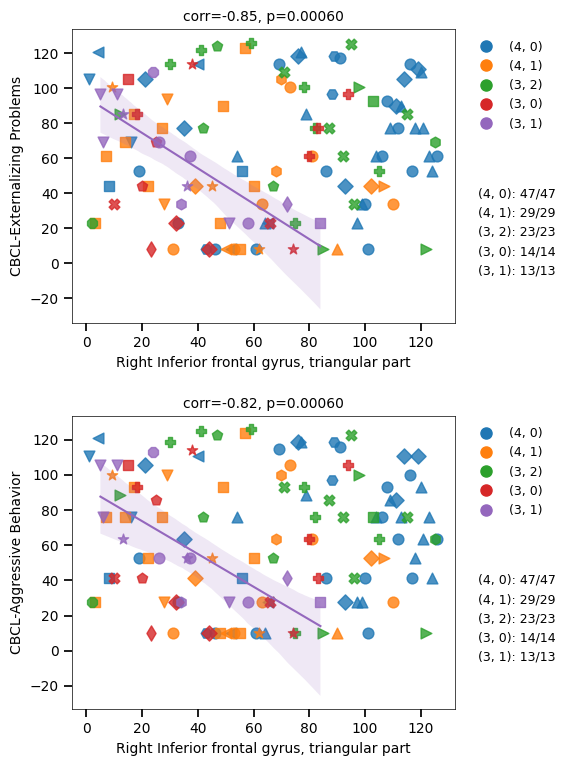

In [74]:
print("PROTOYPE 5")
plot_proto_top5_samples(
    mmt_prt   = mmt_prt_5,
    pmatrix_prt = pmatrix_prt_5,
    samples_df   = asdsamples,
    prototypes_hier_df = asd_prototypes_hier,
    behavior_column_map = behavior_column_map,
    top_pairs_n  = 2,
    top_protos_n = 5,
    proto_rank   = 4
)

In [75]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from scipy.stats import pearsonr
import pandas as pd

def plot_pearson_top5_prototypes(
    mmt_prt: pd.DataFrame,
    rowdf: pd.DataFrame,
    top_pairs_n: int = 5,
    num_protos: int = 5,
    fig_width: float = 12,
    fig_height: float = 5
):
    """
    Plots the top N behavior×ROI by absolute Spearman ρ, then on the raw data:
      - scatters each sample colored by Level 1 and shaped by Level 2
      - regression lines for all samples (black dashed), balanced top2, and each of the top `num_protos` prototypes in tab10 colors
      - annotations of Spearman & Pearson ρ for each prototype
    """
    # 1. pick top by Spearman
    sig = mmt_prt.stack(future_stack=True).reset_index()
    sig.columns = ['Behavior','ROI','Spearman']
    sig['abs_ρ'] = sig['Spearman'].abs()
    top_pairs = sig.sort_values('abs_ρ', ascending=False).head(top_pairs_n)

    # 2. set up subplots
    fig, axes = plt.subplots(top_pairs_n, 1,
                             figsize=(fig_width, fig_height*top_pairs_n),
                             squeeze=False)
    axes = axes.flatten()

    # 3. marker list
    markers = ['o','s','^','D','P','X','v','*','p','<','>','h','H','d','8']

    for ax, row in zip(axes, top_pairs.itertuples(index=False)):
        beh, roi, spearman_val = row.Behavior, row.ROI, row.Spearman

        # filter missing
        df = rowdf[rowdf[beh] > -1].copy()

        # identify top prototypes
        top_levels = df['Level 1'].value_counts().head(num_protos).index.tolist()

        # build color map for Level 1 and marker map for Level 2
        palette = sns.color_palette("tab10", n_colors=len(top_levels))
        level1_colors = {lvl: palette[i] for i, lvl in enumerate(top_levels)}
        lvl2_values    = df['Level 2'].unique()
        level2_markers = {lvl2: markers[i % len(markers)] for i, lvl2 in enumerate(lvl2_values)}

        # prepare balanced top2
        g1, g2 = (df[df['Level 1']==top_levels[0]],
                  df[df['Level 1']==top_levels[1]])
        if len(g1)>len(g2):
            g2 = pd.concat([g2, g2.sample(len(g1)-len(g2), replace=True)])
        else:
            g1 = pd.concat([g1, g1.sample(len(g2)-len(g1), replace=True)])
        balanced = pd.concat([g1, g2])

        # 4. scatter by Level 1 & Level 2
        for lvl1 in top_levels:
            for lvl2 in lvl2_values:
                sub = df[(df['Level 1']==lvl1) & (df['Level 2']==lvl2)]
                if sub.empty:
                    continue
                ax.scatter(
                    sub[roi], sub[beh],
                    color=level1_colors[lvl1],
                    marker=level2_markers[lvl2],
                    s=80, alpha=0.7,
                    edgecolor=('black' if lvl1==top_levels[0] else None)
                )

        # 5. regression lines
        sns.regplot(x=roi, y=beh, data=df,       scatter=False,
                    line_kws={'linestyle':'--','color':'black','linewidth':1.5},
                    ci=None, ax=ax)
        sns.regplot(x=roi, y=beh, data=balanced, scatter=False,
                    line_kws={'linestyle':'-','color':'black','linewidth':1.5},
                    ci=None, ax=ax)
        for i, lvl in enumerate(top_levels):
            grp = df[df['Level 1']==lvl]
            sns.regplot(x=roi, y=beh, data=grp, scatter=False,
                        line_kws={'color':palette[i],'linewidth':1.5},
                        ci=None, ax=ax)

        # 6. compute Pearson ρ per prototype
        pear_vals = [pearsonr(df[df['Level 1']==lvl][roi],
                              df[df['Level 1']==lvl][beh])[0]
                     for lvl in top_levels]

        # 7. annotate Spearman & Pearson
        y0, dy = 0.95, 0.05
        ax.text(0.98, y0,        f"Spearman: {spearman_val:.2f}",
                transform=ax.transAxes, ha='right', va='top', fontsize=10)
        for i, val in enumerate(pear_vals):
            ax.text(0.98, y0-(i+1)*dy,
                    f"Pearson {i+1}: {val:.2f}",
                    transform=ax.transAxes, ha='right', va='top',
                    color=palette[i], fontsize=10)

        # 8. regression legend
        reg_handles = [
            Line2D([0],[0], color='black', linestyle='--', label='All'),
            Line2D([0],[0], color='black', linestyle='-',  label='Balanced'),
        ] + [
            Line2D([0],[0], color=palette[i], linestyle='-', label=f"Proto {i+1}")
            for i in range(len(top_levels))
        ]
        ax.legend(handles=reg_handles, #title='Regression',
                  bbox_to_anchor=(1.02,1), loc='upper left',
                  fontsize=9, frameon=False)

        # 9. finalize
        ax.set_xlabel(roi, fontsize=10)
        ax.set_ylabel(beh, fontsize=10)
        ax.set_title(f"{roi} vs {beh}", fontsize=11)
        ax.tick_params(labelsize=8)
        for spine in ax.spines.values():
            spine.set_linewidth(0.5)

    plt.tight_layout()
    plt.show()

In [76]:
# Parse the Position List into Level 1 and Level 2
def parse_position_list(position_list_str):
    eval_list = eval(position_list_str)  # Convert string to list of tuples
    return eval_list[0], eval_list[1] if len(eval_list) > 1 else (None, None)

# Add hierarchy information from asd_prototypes_hier to rowdf
asd_prototypes_hier = asd_prototypes_hier.copy()
asd_prototypes_hier['Level 1'], asd_prototypes_hier['Level 2'] = zip(*asd_prototypes_hier['Position List'].apply(parse_position_list))
hierarchy_info = asd_prototypes_hier[['Identifier', 'Level 1', 'Level 2', 'Position List', 'BMU Distance']]
rowdf = pd.merge(asdsamples, hierarchy_info, left_on='ID', right_on='Identifier', how='left')


--- Phenotype 1 ---


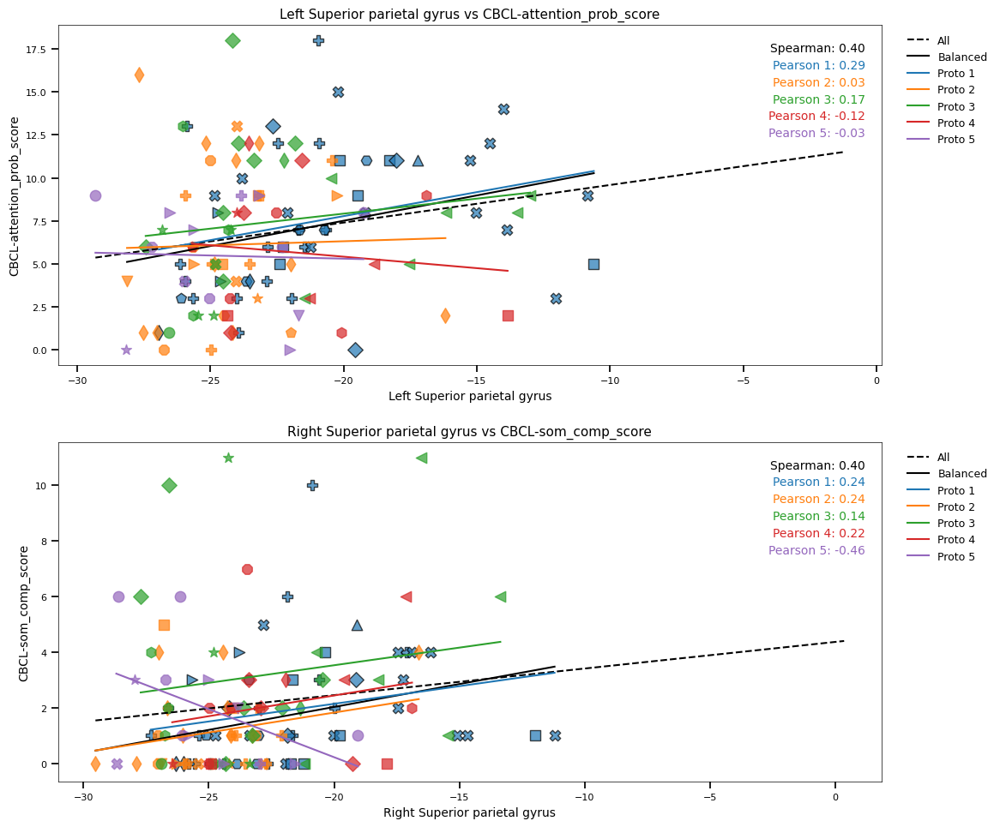


--- Phenotype 2 ---


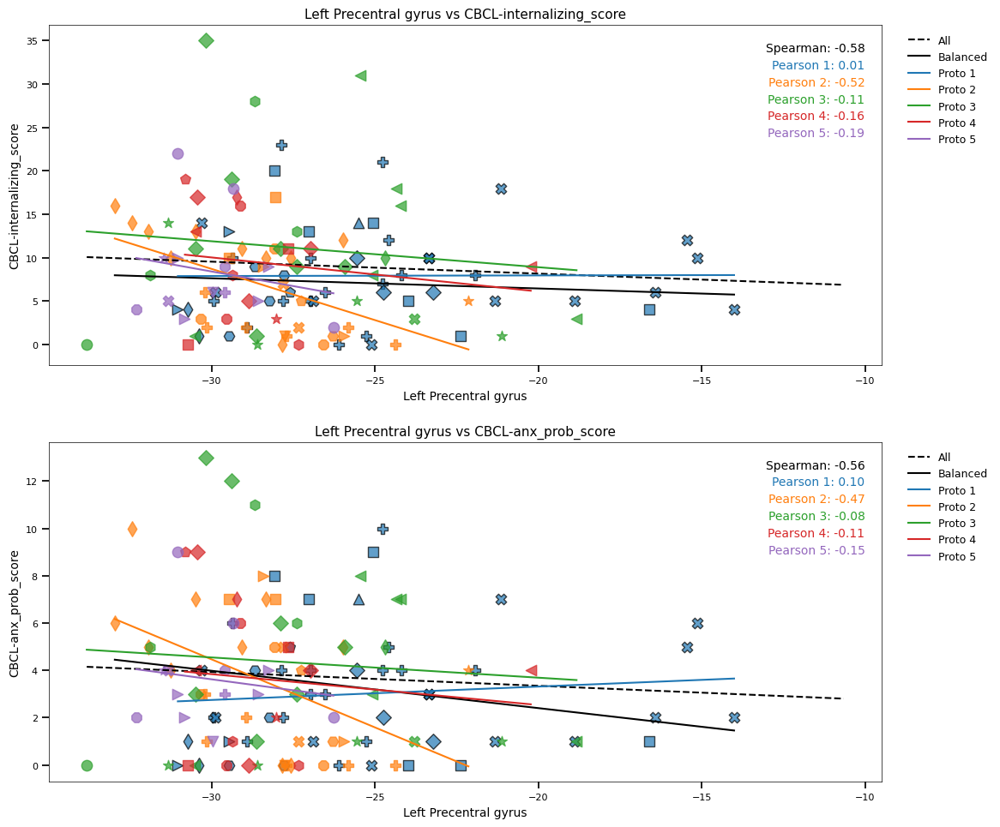


--- Phenotype 3 ---


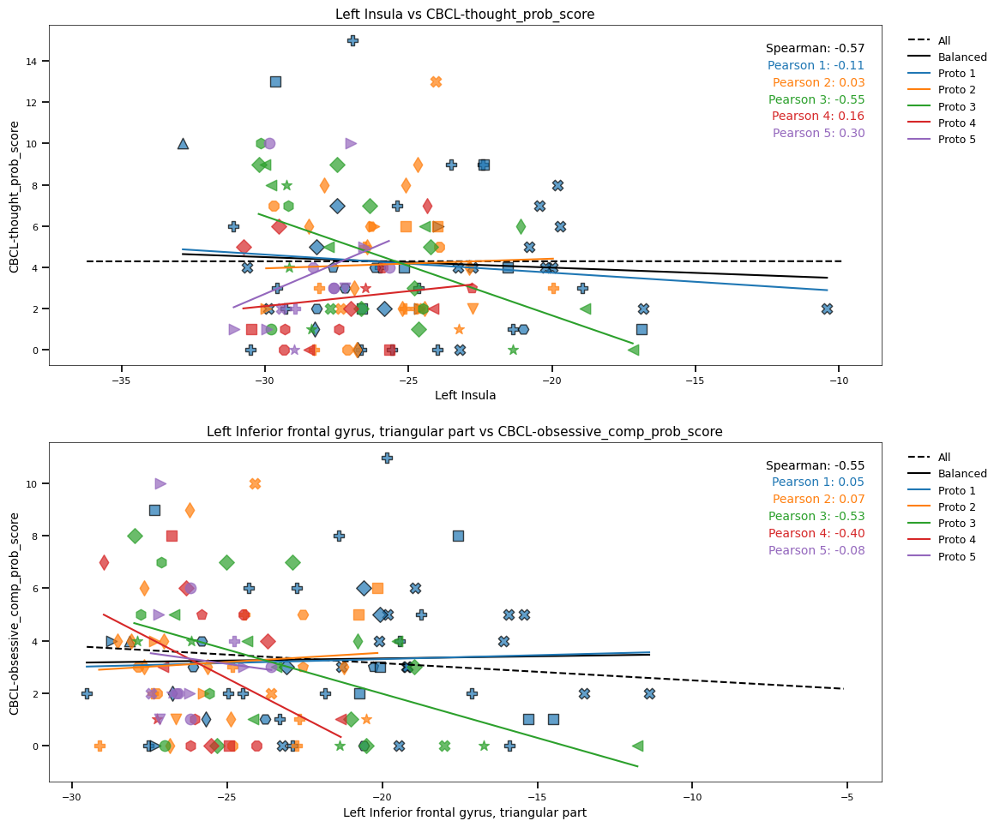


--- Phenotype 4 ---


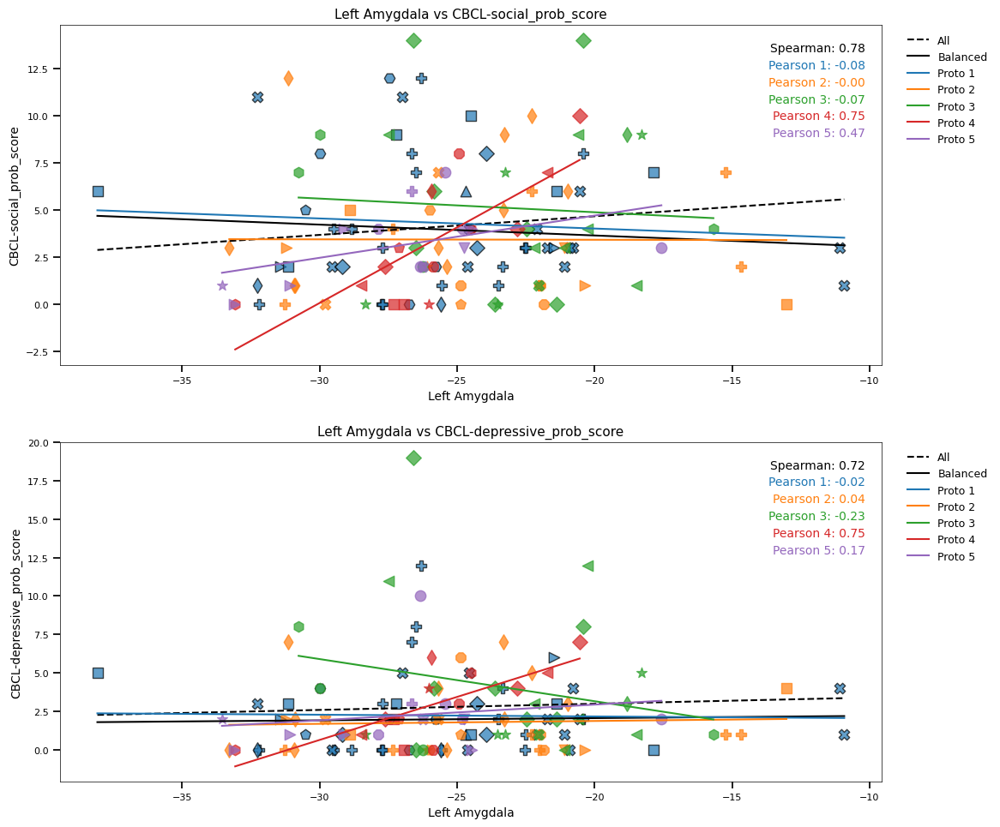


--- Phenotype 5 ---


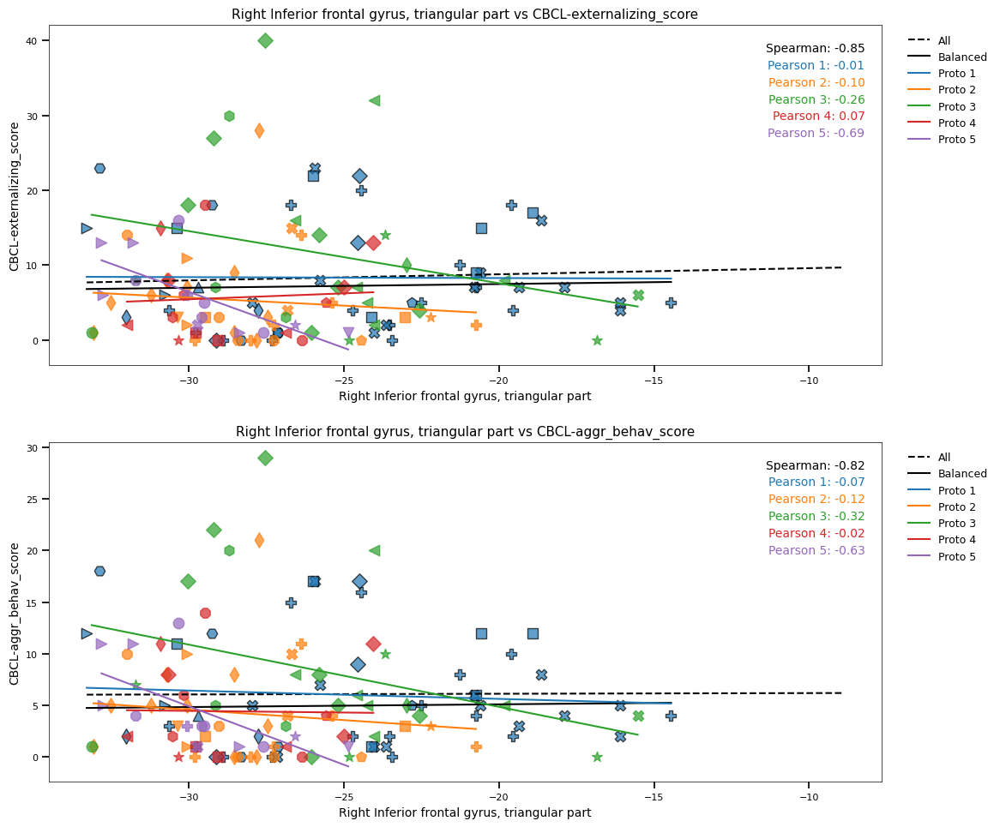

In [77]:
for i, m in enumerate([mmt_prt_1, mmt_prt_2, mmt_prt_3, mmt_prt_4, mmt_prt_5], 1):
    print(f"\n--- Phenotype {i} ---")
    plot_pearson_top5_prototypes(m, rowdf, top_pairs_n=2, num_protos=5)

In [78]:
def get_sorted_pairs(mmt_prt: pd.DataFrame, pmatrix_prt: pd.DataFrame, corrected_pmatrix_prt: pd.DataFrame) -> pd.DataFrame:
    """
    Returns a DataFrame of all non-NA correlations from mmt_prt,
    sorted by absolute value, and with corresponding p-values.
    
    Parameters
    ----------
    mmt_prt : DataFrame
        Correlation matrix (behaviors × ROIs).
    pmatrix_prt : DataFrame
        Matching p-value matrix (behaviors × ROIs).
    
    Returns
    -------
    DataFrame with columns:
      - Behavior:  behavior name
      - ROI:       region of interest name
      - Correlation
      - p_value
    """
    # 1. Stack to long form and drop NA correlations
    sig = mmt_prt.stack(future_stack=True).reset_index()
    sig.columns = ['Behavior', 'ROI', 'Correlation']
    sig = sig.dropna(subset=['Correlation'])
    
    # 2. Add absolute value for sorting
    sig['abs_corr'] = sig['Correlation'].abs()

    # 3. Lookup p-values
    sig['p_value'] = sig.apply(
        lambda row: pmatrix_prt.loc[row['Behavior'], row['ROI']],
        axis=1
    )
    
    sig['adjusted-p'] = sig.apply(
    lambda row: corrected_pmatrix_prt.loc[row['Behavior'], row['ROI']],
    axis=1
    )
    # 4. Sort by absolute correlation and drop helper column
    out = sig.sort_values('abs_corr', ascending=False).drop(columns='abs_corr')

    # 5. (Optional) reset index if you like
    return out.reset_index(drop=True)

In [79]:
get_sorted_pairs(mmt_prt_1, pmatrix_prt_1, corrected_pmatrix_prt_1)

,Behavior,ROI,Correlation,p_value,adjusted-p
0,CBCL-attention_prob_score,Left Superior parietal gyrus,0.402754,0.003800,0.412904
1,CBCL-som_comp_score,Right Superior parietal gyrus,0.402729,0.006599,0.412904
2,CBCL-social_prob_score,Left Superior parietal gyrus,0.396166,0.005599,0.412904
3,CBCL-attention_hyper_prob_score,Left Crus II of cerebellar hemisphere,0.395913,0.007799,0.412904
4,CBCL-total_problems_score,"Right Superior frontal gyrus, dorsolateral",0.392573,0.008999,0.412904
...,...,...,...,...,...
71,CBCL-attention_prob_score,"Left Superior frontal gyrus, dorsolateral",0.291561,0.046795,0.431849
72,CBCL-depressive_prob_score,Right Cuneus,0.289041,0.045595,0.431849
73,CBCL-internalizing_score,Right Precuneus,0.288434,0.049595,0.438926
74,CBCL-som_comp_score,Left Superior parietal gyrus,0.287173,0.046995,0.431849


In [80]:
get_sorted_pairs(mmt_prt_2, pmatrix_prt_2, corrected_pmatrix_prt_2)

,Behavior,ROI,Correlation,p_value,adjusted-p
0,CBCL-internalizing_score,Left Precentral gyrus,-0.582216,0.000800,0.543946
1,CBCL-anx_prob_score,Left Precentral gyrus,-0.556223,0.002000,0.679932
2,CBCL-oppo_def_prob_score,Right Cuneus,0.523991,0.004000,0.679932
3,CBCL-thought_prob_score,Left Precentral gyrus,-0.521860,0.003800,0.679932
4,CBCL-anxious_score,Left Precentral gyrus,-0.518919,0.005999,0.679932
5,CBCL-sluggish_cogn_tempo_score,Left Precentral gyrus,-0.499342,0.006799,0.679932
6,CBCL-depressed_score,Left Middle frontal gyrus,-0.494807,0.007799,0.679932
7,CBCL-internalizing_score,Left Middle frontal gyrus,-0.477798,0.009799,0.740370
8,CBCL-total_problems_score,Left Precentral gyrus,-0.473444,0.007999,0.679932
9,CBCL-depressed_score,Left Precentral gyrus,-0.459373,0.012999,0.828281


In [81]:
get_sorted_pairs(mmt_prt_3, pmatrix_prt_3, corrected_pmatrix_prt_3)

,Behavior,ROI,Correlation,p_value,adjusted-p
0,CBCL-thought_prob_score,Left Insula,-0.571935,0.005000,0.781922
1,CBCL-obsessive_comp_prob_score,"Left Inferior frontal gyrus, triangular part",-0.549931,0.008199,0.781922
2,CBCL-som_prob_score,Right Amygdala,-0.547067,0.007999,0.781922
3,CBCL-som_comp_score,Right Amygdala,-0.526104,0.011599,0.781922
4,CBCL-aggr_behav_score,Left Insula,-0.525254,0.010999,0.781922
5,CBCL-sluggish_cogn_tempo_score,Right Amygdala,-0.517782,0.009399,0.781922
6,CBCL-depressive_prob_score,Left Insula,-0.517168,0.010999,0.781922
7,CBCL-total_problems_score,Left Insula,-0.513353,0.011399,0.781922
8,CBCL-sluggish_cogn_tempo_score,Right Anterior cingulate and paracingulate gyri,-0.508320,0.012599,0.781922
9,CBCL-sluggish_cogn_tempo_score,Left Anterior cingulate and paracingulate gyri,-0.506743,0.012399,0.781922


In [82]:
get_sorted_pairs(mmt_prt_4, pmatrix_prt_4, corrected_pmatrix_prt_4)

,Behavior,ROI,Correlation,p_value,adjusted-p
0,CBCL-social_prob_score,Left Amygdala,0.775125,0.001800,1.0
1,CBCL-depressive_prob_score,Left Amygdala,0.715600,0.004800,1.0
2,CBCL-attention_prob_score,Left Amygdala,0.713200,0.004600,1.0
3,CBCL-depressed_score,Right Posterior cingulate gyrus,0.671957,0.010799,1.0
4,CBCL-depressed_score,Left Posterior cingulate gyrus,0.638471,0.015398,1.0
5,CBCL-sluggish_cogn_tempo_score,Right Thalamus,0.609311,0.022598,1.0
6,CBCL-depressive_prob_score,Right Posterior cingulate gyrus,0.606704,0.023998,1.0
7,CBCL-social_prob_score,Right Posterior cingulate gyrus,0.601390,0.028797,1.0
8,CBCL-attention_hyper_prob_score,Left Amygdala,0.584481,0.027597,1.0
9,CBCL-oppo_def_prob_score,Left Cuneus,-0.572910,0.036596,1.0


In [83]:
get_sorted_pairs(mmt_prt_5, pmatrix_prt_5, corrected_pmatrix_prt_5)

,Behavior,ROI,Correlation,p_value,adjusted-p
0,CBCL-externalizing_score,"Right Inferior frontal gyrus, triangular part",-0.851635,0.000600,0.203980
1,CBCL-aggr_behav_score,"Right Inferior frontal gyrus, triangular part",-0.822061,0.000600,0.203980
2,CBCL-anx_prob_score,Right Superior temporal gyrus,-0.794622,0.002200,0.498617
3,CBCL-conduct_prob_score,"Right Inferior frontal gyrus, triangular part",-0.749769,0.005000,0.560944
4,CBCL-obsessive_comp_prob_score,Right Posterior cingulate gyrus,0.745404,0.004200,0.560944
5,CBCL-oppo_def_prob_score,"Right Inferior frontal gyrus, triangular part",-0.736223,0.006399,0.560944
6,CBCL-som_comp_score,Right Amygdala,0.730869,0.006199,0.560944
7,CBCL-attention_hyper_prob_score,"Right Inferior frontal gyrus, triangular part",-0.726359,0.006599,0.560944
8,CBCL-anx_prob_score,Right Superior parietal gyrus,-0.704452,0.007999,0.604384
9,CBCL-attention_hyper_prob_score,Left Fusiform gyrus,0.692835,0.011799,0.802320


In [84]:
#sorted_pairs.to_csv("g_sigcorr_v1_top19.csv", index=False)

In [85]:
# sorted_pairs.to_csv("g_sigcorr_v2_top19.csv", index=False)